In [18]:
import pandas as pd
import os
import seaborn as sns

os.chdir("/net/trapnell/vol1/home/mdcolon/proj/morphseq")
from src.legacy.vae import assess_vae_results

from src.functions.embryo_df_performance_metrics import (split_train_test, 
                                                        logistic_regression_multiclass, 
                                                        f1_score_over_time_multiclass,
                                                        plot_f1_score_over_time,
                                                        create_f1_score_dataframe,
                                                        compute_average_f1_score,
                                                        plot_average_f1_score_difference,
                                                        compute_metrics_for_dataframes,
                                                        compute_differences,
                                                        compute_graph_metrics,
                                                        compute_histogram,
                                                        compute_kl_divergence,
                                                        plot_differences_together,
                                                        random_subsample,
                                                        compute_jaccard_similarities,
                                                        plot_jaccard_results,
                                                        produce_performance_metrics,)

pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
#these arefunctions that will search for the embryo_stats_csv file and then attempt to create it
def find_embryo_stats_csv(model_path):
    """
    Recursively search for the 'embryo_stats_df.csv' file starting from model_path.
    Parameters:
        model_path (str): The base path to start searching.
    Returns:
        str: The full path to the 'embryo_stats_df.csv' file if found, otherwise None.
    """
    target_file = 'embryo_stats_df.csv'
    
    for root, dirs, files in os.walk(model_path):
        if target_file in files and 'figures' in root:
            return os.path.join(root, target_file)
    
    print(f"File '{target_file}' not found under {model_path}")
    return None


def get_embryo_df_path(model_path):
    embryo_df_path = find_embryo_stats_csv(model_path)
    
    if embryo_df_path is None:
        print(f"File 'embryo_stats_df.csv' not found under {model_path}")
        print("Attempting to generate 'embryo_stats_df.csv'...")
        
        path_parts = model_path.strip(os.sep).split(os.sep)
        
        try:
            model_name = os.path.basename(model_path)
            # a couple of parameters for the model assessment script
            overwrite_flag = False # will skip if it detects the exprected output data already
            n_image_figures = 100  # make qualitative side-by-side reconstruction figures
            assess_vae_results(root, train_folder, model_name, n_image_figures=n_image_figures, overwrite_flag=overwrite_flag, batch_size=64, skip_figures_flag=True)

            # Try to find the 'embryo_stats_df.csv' again
            embryo_df_path = find_embryo_stats_csv(model_path)
            
            if embryo_df_path is None:
                print(f"Failed to generate 'embryo_stats_df.csv' under {model_path}")
        except ValueError:
            print(f"Could not parse 'model_path' to extract necessary components: {model_path}")
            embryo_df_path = None
        except ImportError:
            print("Could not import 'assess_vae_results'. Please ensure it is correctly imported.")
            embryo_df_path = None
        except Exception as e:
            print(f"An error occurred while generating 'embryo_stats_df.csv': {e}")
            embryo_df_path = None
    return embryo_df_path


def plot_pca_highlighted_embryos(
    test_df,
    z_mu_biological_columns,
    perturbations=None,
    highlight_embryos=None,
    highlight_colors=None,
    marker_size=5,
    highlight_marker_size=10,
    opacity=0.7,
    title="3D PCA Plot",
    show_legend=True,
    plot=True,
    downsample=True,
    wt_downsample_frac=0.05,
    non_wt_downsample_frac=0.05,
    random_state=42
):
    # Copy the dataframe to avoid modifying the original data
    df = test_df.copy()

    # Downsample data if enabled
    if downsample:
        # Identify unique perturbation groups
        groups = df['phenotype'].unique()
        downsampled_dfs = []

        for group in groups:
            group_df = df[df['phenotype'] == group]
            unique_embryos = group_df['embryo_id'].unique()
            
            # Set downsampling fraction
            if group == 'wt':
                downsample_frac = wt_downsample_frac
            else:
                downsample_frac = non_wt_downsample_frac
            
            # Calculate the number of embryos to sample
            n_sample = max(1, int(len(unique_embryos) * downsample_frac))
            
            # Randomly sample embryo_ids
            sampled_embryos = np.random.RandomState(random_state).choice(
                unique_embryos, size=n_sample, replace=False
            )
            
            # Filter the group dataframe
            group_df_sampled = group_df[group_df['embryo_id'].isin(sampled_embryos)]
            downsampled_dfs.append(group_df_sampled)

        # Combine downsampled data
        df = pd.concat(downsampled_dfs, ignore_index=True)
        
    # Prepare data for PCA
    X = df[z_mu_biological_columns].values

    # Perform PCA
    pca = PCA(n_components=3)
    pcs = pca.fit_transform(X)
    df_pca = pd.DataFrame(pcs, columns=['PC1', 'PC2', 'PC3'])
    df_pca = pd.concat([df.reset_index(drop=True), df_pca], axis=1)

    # Prepare color and size settings
    if perturbations is None:
        perturbations = df_pca['phenotype'].unique()
    color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}
    
    # Handle embryo highlighting
    df_pca['marker_size'] = marker_size
    df_pca['opacity'] = opacity
    df_pca['color'] = df_pca['phenotype'].map(color_discrete_map)

    if highlight_embryos:
        if highlight_colors is None:
            highlight_colors = ['red'] * len(highlight_embryos)
        highlight_dict = dict(zip(highlight_embryos, highlight_colors))
        df_pca.loc[df_pca['embryo_id'].isin(highlight_embryos), 'marker_size'] = highlight_marker_size
        df_pca.loc[df_pca['embryo_id'].isin(highlight_embryos), 'color'] = df_pca['embryo_id'].map(highlight_dict)
        df_pca.loc[df_pca['embryo_id'].isin(highlight_embryos), 'opacity'] = 1.0

    if plot:
        fig = px.scatter_3d(
            df_pca,
            x='PC1',
            y='PC2',
            z='PC3',
            # color='phenotype',
            size='marker_size',
            opacity=opacity,
            title=title,
            color_discrete_map=color_discrete_map
        )

        if not show_legend:
            fig.update_layout(showlegend=False)

        fig.show()

    return fig  # Return the figure object for further use

    
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import seaborn as sns

plt.style.use('default')

def plot_pca_2d_highlighted_embryos_matplotlib(test_df, z_mu_biological_columns, downsample_wt=False, wt_downsample_frac=0.1, marker_size=3, pert_comparisons=pert_comparisons,title=None):
    """
    Plots a 2D PCA projection of the data with wild-type embryos optionally downsampled.
    
    Parameters:
        test_df (pd.DataFrame): Test dataset.
        z_mu_biological_columns (list): Columns representing latent variables.
        downsample_wt (bool): Whether to downsample wild-type data.
        wt_downsample_frac (float): Fraction of wild-type data to keep if downsampling.
        marker_size (int): Size of the scatterplot markers.
        pert_comparisons (list): List of phenotypes to include in the plot.
    """
    # Perform PCA
    pca = PCA(n_components=2)
    if pert_comparisons:
        test_df = test_df[test_df["phenotype"].isin(pert_comparisons)]
    pca_result = pca.fit_transform(test_df[z_mu_biological_columns])

    # Add PCA columns to the dataframe
    test_df['PCA1'] = pca_result[:, 0]
    test_df['PCA2'] = pca_result[:, 1]

    # Optional: Downsample wild-type embryos
    if downsample_wt:
        wt_mask = test_df['phenotype'] == 'wt'
        non_wt_df = test_df[~wt_mask]
        wt_df = test_df[wt_mask].sample(frac=wt_downsample_frac, random_state=42)
        test_df = pd.concat([wt_df, non_wt_df])

    # Get unique phenotypes and assign seaborn colors
    unique_phenotypes = test_df['phenotype'].unique()
    palette = sns.color_palette("deep", len(unique_phenotypes))
    color_map = dict(zip(unique_phenotypes, palette))
    test_df['color'] = test_df['phenotype'].map(color_map)

    # Plot the data
    plt.figure(figsize=(10, 8))
    for phenotype, group_df in test_df.groupby('phenotype'):
        plt.scatter(
            group_df['PCA1'], 
            group_df['PCA2'], 
            c=[color_map[phenotype]], 
            label=phenotype, 
            s=marker_size, 
            alpha=0.7
        )

    # Add a legend
    plt.legend(title="Phenotypes")
    if title:
        plt.title(title)
    else:
        plt.title('PCA 2D Projection with Highlighted Embryos')
    plt.xlabel('PCA1')
    plt.ylabel('PCA2')
    plt.grid(alpha=0.3)
    plt.tight_layout()

    # Show the plot
    plt.show()

# Defining Function

In [ ]:
class LocalPrincipalCurve:
    def __init__(self, bandwidth=0.2, max_iter=100, tol=1e-4, angle_penalty_exp=2, h=None):
        """
        Initialize the Local Principal Curve solver.

        Parameters:
        - bandwidth: The kernel bandwidth (h). If h is not provided, bandwidth is used as h.
        - max_iter: Maximum number of iterations for forward/backward runs.
        - tol: Tolerance for stopping criterion based on changes in µ_x.
        - angle_penalty_exp: Exponent k used in angle penalization: a_x(i) = |cos(alpha_x(i))|^k.
        - h: Step size t0. If None, set t0 = bandwidth.
        """

        
        self.bandwidth = bandwidth
        self.h = h if h is not None else self.bandwidth
        self.max_iter = max_iter
        self.tol = tol
        self.angle_penalty_exp = angle_penalty_exp
        
        self.initializations = []
        self.paths = []
        self.cubic_splines_eq = []
        self.cubic_splines = []

    def _kernel_weights(self, dataset, x):
        """Compute Gaussian kernel weights w_i = K_h(X_i - x)."""
        dists = np.linalg.norm(dataset - x, axis=1)
        weights = np.exp(- (dists**2) / (2 * self.bandwidth**2))
        w = weights / np.sum(weights)
        return w

    def _local_center_of_mass(self, dataset, x):
        """Compute µ_x, the local center of mass around x."""
        w = self._kernel_weights(dataset, x)
        mu = np.sum(dataset.T * w, axis=1)
        return mu

    def _local_covariance(self, dataset, x, mu):
        """Compute the local covariance matrix Σ_x."""
        w = self._kernel_weights(dataset, x)
        centered = dataset - mu
        cov = np.zeros((dataset.shape[1], dataset.shape[1]))
        for i in range(len(dataset)):
            cov += w[i] * np.outer(centered[i], centered[i])
        return cov

    def _principal_component(self, cov, prev_vec=None):
        """Compute the first local principal component γ_x, with angle penalization."""
        vals, vecs = np.linalg.eig(cov)
        idx = np.argsort(vals)[::-1]
        vals = vals[idx]
        vecs = vecs[:, idx]

        gamma = vecs[:, 0]  # first principal component

        # Sign flipping to maintain direction if prev_vec is given
        if prev_vec is not None and np.linalg.norm(prev_vec) != 0:
            cos_alpha = np.dot(gamma, prev_vec) / (np.linalg.norm(gamma)*np.linalg.norm(prev_vec))
            if cos_alpha < 0:
                gamma = -gamma

            # Angle penalization
            cos_alpha = np.dot(gamma, prev_vec) / (np.linalg.norm(gamma)*np.linalg.norm(prev_vec))
            a_x = (abs(cos_alpha))**self.angle_penalty_exp
            gamma = a_x * gamma + (1 - a_x) * prev_vec
            gamma /= np.linalg.norm(gamma)

        return gamma

    def _forward_run(self, dataset, x_start):
        """Run the algorithm forward from a starting point using the full dataset."""
        x = x_start
        path_x = [x]
        prev_gamma = None

        for _ in range(self.max_iter):
            mu = self._local_center_of_mass(dataset, x)
            cov = self._local_covariance(dataset, x, mu)
            gamma = self._principal_component(cov, prev_vec=prev_gamma)

            x_new = mu + self.h * gamma

            # Check convergence
            if np.linalg.norm(mu - x) < self.tol:
                path_x.append(x_new)
                break

            path_x.append(x_new)
            x = x_new
            prev_gamma = gamma

        return np.array(path_x)

    def _backward_run(self, dataset, x0, gamma0):
        """Run the algorithm backwards from x(0) along -γ_x(0) using the full dataset."""
        x = x0
        path_x = [x]
        prev_gamma = -gamma0

        for _ in range(self.max_iter):
            mu = self._local_center_of_mass(dataset, x)
            cov = self._local_covariance(dataset, x, mu)
            gamma = self._principal_component(cov, prev_vec=prev_gamma)

            x_new = mu + self.h * gamma

            if np.linalg.norm(mu - x) < self.tol:
                path_x.append(x_new)
                break

            path_x.append(x_new)
            x = x_new
            prev_gamma = gamma

        return np.array(path_x)

    def _find_starting_point(self, dataset, start_point):
        """Ensure starting point is in dataset or choose closest."""
        if start_point is None:
            idx = np.random.choice(len(dataset))
            return dataset[idx], idx
        else:
            diffs = dataset - start_point
            dists = np.linalg.norm(diffs, axis=1)
            min_idx = np.argmin(dists)
            closest_pt = dataset[min_idx]
            if not np.allclose(closest_pt, start_point):
                print(f"Starting point not in dataset. Using closest point: {closest_pt}")
            return closest_pt, min_idx

    def fit(self, dataset, start_points=None):
        """
        Fit LPC on the dataset using possibly multiple starting points.

        Parameters:
        - dataset: n x p array
        - start_points: List of starting points or None.

        Returns:
        - self.paths: List of arrays, each array is a path from one initialization.
        """
        dataset = np.array(dataset)
        self.paths = []
        self.initializations = []

        if start_points is None:
            start_points = [None]

        for sp in start_points:
            x0, _ = self._find_starting_point(dataset, sp)

            forward_path = self._forward_run(dataset, x0)
            if len(forward_path) > 1:
                initial_gamma_direction = (forward_path[1] - forward_path[0]) / self.h
            else:
                initial_gamma_direction = np.zeros(dataset.shape[1])

            if np.linalg.norm(initial_gamma_direction) > 0:
                backward_path = self._backward_run(dataset, x0, initial_gamma_direction)
                full_path = np.vstack([backward_path[::-1], forward_path[1:]])
            else:
                full_path = forward_path

            self.paths.append(full_path)
            self.initializations.append(x0)

        self._fit_cubic_splines_eq()
        self._compute_cubic_spline_points()
        return self.paths

    def _fit_cubic_splines_eq(self):
        """Fit cubic splines (equations) for all paths."""
        self.cubic_splines_eq = []
        for path in self.paths:
            if len(path) < 4:
                self.cubic_splines_eq.append(None)
                continue
            t = np.arange(len(path))
            splines_dict = {}
            for dim in range(path.shape[1]):
                splines_dict[dim] = CubicSpline(t, path[:, dim])
            self.cubic_splines_eq.append(splines_dict)

    def _compute_cubic_spline_points(self, num_points=500):
        """
        Compute parameterized points from each cubic spline equation.
        This fills self.cubic_splines with arrays of evaluated points.
        """
        self.cubic_splines = []
        for i, eq in enumerate(self.cubic_splines_eq):
            if eq is None:
                self.cubic_splines.append(None)
                continue
            path = self.paths[i]
            t_values = np.linspace(0, len(path) - 1, num_points)
            spline_points = self.evaluate_cubic_spline(i, t_values)
            self.cubic_splines.append(spline_points)

    def evaluate_cubic_spline(self, path_idx, t_values):
        """Evaluate the cubic spline equation for a specific path at given parameter values."""
        if path_idx >= len(self.cubic_splines_eq) or self.cubic_splines_eq[path_idx] is None:
            raise ValueError(f"No cubic spline found for path index {path_idx}.")
        spline = self.cubic_splines_eq[path_idx]
        points = np.array([spline[dim](t_values) for dim in range(len(spline))]).T
        return points

    def plot_path_3d(self, dataset, path_idx=0):
        """Plot dataset and one LPC path in 3D for visualization."""
        import matplotlib.pyplot as plt

        dataset = np.array(dataset)
        path = self.paths[path_idx]
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(dataset[:,0], dataset[:,1], dataset[:,2], alpha=0.5, label='Data')
        ax.plot(path[:,0], path[:,1], path[:,2], 'r-', label='Local Principal Curve')
        ax.legend()
        plt.show()

    def plot_cubic_spline_3d(self, path_idx, t_values=None, show_path=True):
        """
        Plot the cubic spline for a specific path in 3D.

        Parameters:
        - path_idx: Index of the path to plot the spline for.
        - t_values: Optional parameter values to plot the spline at.
                    If None, t_values will be automatically generated.
        - show_path: Boolean flag to indicate whether to plot the LPC path points.
        """
        import matplotlib.pyplot as plt

        if path_idx >= len(self.paths):
            raise IndexError(f"Path index {path_idx} is out of range. Total paths: {len(self.paths)}.")

        path = self.paths[path_idx]
        if t_values is None:
            t_values = np.linspace(0, len(path) - 1, 500)

        spline_points = self.evaluate_cubic_spline(path_idx, t_values)

        fig = plt.figure()
        ax = fig.add_subplot(111, projection="3d")

        if show_path:
            ax.scatter(path[:, 0], path[:, 1], path[:, 2], label="LPC Path", alpha=0.5)

        ax.plot(spline_points[:, 0], spline_points[:, 1], spline_points[:, 2], color="red", label="Cubic Spline")
        ax.legend()
        plt.show()

In [86]:

class LocalPrincipalCurve:
    def __init__(self, bandwidth=0.5, max_iter=500, tol=1e-3, angle_penalty_exp=2, h=None,
                 use_knn_graph=False, knn_k=30):

        """
        Initialize the Local Principal Curve solver.

        Parameters:
        - bandwidth: The kernel bandwidth (h). If h is not provided, bandwidth is used as h.
        - max_iter: Maximum number of iterations for forward/backward runs.
        - tol: Tolerance for stopping criterion based on changes in µ_x.
        - angle_penalty_exp: Exponent k used in angle penalization: a_x(i) = |cos(alpha_x(i))|^k.
        - h: Step size t0. If None, set t0 = bandwidth.
        """
        self.bandwidth = bandwidth
        self.h = h if h is not None else self.bandwidth
        self.max_iter = max_iter
        self.tol = tol
        self.angle_penalty_exp = angle_penalty_exp
        self.use_knn_graph = use_knn_graph
        self.knn_k = knn_k

        self.initializations = []
        self.paths = []
        self.cubic_splines_eq = []
        self.cubic_splines = []
        self.neigh = None

    def _kernel_weights(self, dataset, x):
        if self.use_knn_graph and self.neigh is not None:
            # Find the k nearest neighbors of x
            neigh_indices = self.neigh.kneighbors([x], return_distance=False)[0]
            candidate_points = dataset[neigh_indices]
            dists = np.linalg.norm(candidate_points - x, axis=1)
            weights = np.exp(- (dists**2) / (2 * self.bandwidth**2))
            w = weights / np.sum(weights)
            return w, neigh_indices
        else:
            # Original code: use all points
            dists = np.linalg.norm(dataset - x, axis=1)
            weights = np.exp(- (dists**2) / (2 * self.bandwidth**2))
            w = weights / np.sum(weights)
            return w, np.arange(len(dataset))

   
    def _build_knn_graph(self, dataset):
        self.neigh = NearestNeighbors(n_neighbors=self.knn_k, algorithm='auto')
        self.neigh.fit(dataset)

    def _local_center_of_mass(self, dataset, x):
        w, neigh_indices = self._kernel_weights(dataset, x)
        # If using KNN graph, only sum over neighbors:
        if self.use_knn_graph:
            mu = np.sum(dataset[neigh_indices].T * w, axis=1)
        else:
            mu = np.sum(dataset.T * w, axis=1)
        return mu

    def _local_covariance(self, dataset, x, mu):
        w, neigh_indices = self._kernel_weights(dataset, x)
        if self.use_knn_graph:
            centered = dataset[neigh_indices] - mu
        else:
            centered = dataset - mu
        cov = np.zeros((centered.shape[1], centered.shape[1]))
        for i in range(len(centered)):
            cov += w[i] * np.outer(centered[i], centered[i])
        return cov

    def _principal_component(self, cov, prev_vec=None):
        """Compute the first local principal component γ_x, with angle penalization."""
        vals, vecs = np.linalg.eig(cov)
        idx = np.argsort(vals)[::-1]
        vals = vals[idx]
        vecs = vecs[:, idx]

        gamma = vecs[:, 0]  # first principal component

        # Sign flipping to maintain direction if prev_vec is given
        if prev_vec is not None and np.linalg.norm(prev_vec) != 0:
            cos_alpha = np.dot(gamma, prev_vec) / (np.linalg.norm(gamma)*np.linalg.norm(prev_vec))
            if cos_alpha < 0:
                gamma = -gamma

            # Angle penalization
            cos_alpha = np.dot(gamma, prev_vec) / (np.linalg.norm(gamma)*np.linalg.norm(prev_vec))
            a_x = (abs(cos_alpha))**self.angle_penalty_exp
            gamma = a_x * gamma + (1 - a_x) * prev_vec
            gamma /= np.linalg.norm(gamma)

        return gamma

    def _forward_run(self, dataset, x_start):
        """Run the algorithm forward from a starting point using the full dataset."""
        x = x_start
        path_x = [x]
        prev_gamma = None

        for _ in range(self.max_iter):
            mu = self._local_center_of_mass(dataset, x)
            cov = self._local_covariance(dataset, x, mu)
            gamma = self._principal_component(cov, prev_vec=prev_gamma)

            x_new = mu + self.h * gamma

            # Check convergence
            if np.linalg.norm(mu - x) < self.tol:
                path_x.append(x_new)
                break

            path_x.append(x_new)
            x = x_new
            prev_gamma = gamma

        return np.array(path_x)

    def _backward_run(self, dataset, x0, gamma0):
        """Run the algorithm backwards from x(0) along -γ_x(0) using the full dataset."""
        x = x0
        path_x = [x]
        prev_gamma = -gamma0

        for _ in range(self.max_iter):
            mu = self._local_center_of_mass(dataset, x)
            cov = self._local_covariance(dataset, x, mu)
            gamma = self._principal_component(cov, prev_vec=prev_gamma)

            x_new = mu + self.h * gamma

            if np.linalg.norm(mu - x) < self.tol:
                path_x.append(x_new)
                break

            path_x.append(x_new)
            x = x_new
            prev_gamma = gamma

        return np.array(path_x)

    def _find_starting_point(self, dataset, start_point):
        """Ensure starting point is in dataset or choose closest."""
        if start_point is None:
            idx = np.random.choice(len(dataset))
            return dataset[idx], idx
        else:
            diffs = dataset - start_point
            dists = np.linalg.norm(diffs, axis=1)
            min_idx = np.argmin(dists)
            closest_pt = dataset[min_idx]
            if not np.allclose(closest_pt, start_point):
                print(f"Starting point not in dataset. Using closest point: {closest_pt}")
            return closest_pt, min_idx

    def fit(self, dataset, start_points=None):
            dataset = np.array(dataset)
            self.paths = []
            self.initializations = []

            # Build KNN graph if requested
            if self.use_knn_graph:
                self._build_knn_graph(dataset)

            if start_points is None:
                start_points = [None]

            for sp in start_points:
                x0, _ = self._find_starting_point(dataset, sp)

                forward_path = self._forward_run(dataset, x0)
                if len(forward_path) > 1:
                    initial_gamma_direction = (forward_path[1] - forward_path[0]) / self.h
                else:
                    initial_gamma_direction = np.zeros(dataset.shape[1])

                if np.linalg.norm(initial_gamma_direction) > 0:
                    backward_path = self._backward_run(dataset, x0, initial_gamma_direction)
                    full_path = np.vstack([backward_path[::-1], forward_path[1:]])
                else:
                    full_path = forward_path

                self.paths.append(full_path)
                self.initializations.append(x0)

            self._fit_cubic_splines_eq()
            self._compute_cubic_spline_points()
            return self.paths

    def _fit_cubic_splines_eq(self):
        """Fit cubic splines (equations) for all paths."""
        self.cubic_splines_eq = []
        for path in self.paths:
            if len(path) < 4:
                self.cubic_splines_eq.append(None)
                continue
            t = np.arange(len(path))
            splines_dict = {}
            for dim in range(path.shape[1]):
                splines_dict[dim] = CubicSpline(t, path[:, dim])
            self.cubic_splines_eq.append(splines_dict)

    def _compute_cubic_spline_points(self, num_points=500):
        """
        Compute parameterized points from each cubic spline equation.
        This fills self.cubic_splines with arrays of evaluated points.
        """
        self.cubic_splines = []
        for i, eq in enumerate(self.cubic_splines_eq):
            if eq is None:
                self.cubic_splines.append(None)
                continue
            path = self.paths[i]
            t_values = np.linspace(0, len(path) - 1, num_points)
            spline_points = self.evaluate_cubic_spline(i, t_values)
            self.cubic_splines.append(spline_points)

    def evaluate_cubic_spline(self, path_idx, t_values):
        """Evaluate the cubic spline equation for a specific path at given parameter values."""
        if path_idx >= len(self.cubic_splines_eq) or self.cubic_splines_eq[path_idx] is None:
            raise ValueError(f"No cubic spline found for path index {path_idx}.")
        spline = self.cubic_splines_eq[path_idx]
        points = np.array([spline[dim](t_values) for dim in range(len(spline))]).T
        return points

    def plot_path_3d(self, dataset, path_idx=0):
        """Plot dataset and one LPC path in 3D for visualization."""
        import matplotlib.pyplot as plt

        dataset = np.array(dataset)
        path = self.paths[path_idx]
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(dataset[:,0], dataset[:,1], dataset[:,2], alpha=0.5, label='Data')
        ax.plot(path[:,0], path[:,1], path[:,2], 'r-', label='Local Principal Curve')
        ax.legend()
        plt.show()

    def plot_cubic_spline_3d(self, path_idx, t_values=None, show_path=True):
        """
        Plot the cubic spline for a specific path in 3D.

        Parameters:
        - path_idx: Index of the path to plot the spline for.
        - t_values: Optional parameter values to plot the spline at.
                    If None, t_values will be automatically generated.
        - show_path: Boolean flag to indicate whether to plot the LPC path points.
        """
        import matplotlib.pyplot as plt

        if path_idx >= len(self.paths):
            raise IndexError(f"Path index {path_idx} is out of range. Total paths: {len(self.paths)}.")

        path = self.paths[path_idx]
        if t_values is None:
            t_values = np.linspace(0, len(path) - 1, 500)

        spline_points = self.evaluate_cubic_spline(path_idx, t_values)

        fig = plt.figure()
        ax = fig.add_subplot(111, projection="3d")

        if show_path:
            ax.scatter(path[:, 0], path[:, 1], path[:, 2], label="LPC Path", alpha=0.5)

        ax.plot(spline_points[:, 0], spline_points[:, 1], spline_points[:, 2], color="red", label="Cubic Spline")
        ax.legend()
        plt.show()

In [8]:
merged_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis/paired_models_and_metrics_df.csv")
merged_df_avg = merged_df[merged_df["Perturbation"]=="avg_pert"]

71
0.713932407655193


/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/2211376427.py:12: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/2211376427.py:15: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



PCA plot model_idx 71: F1 score 0.71,mweight 25, timeonly 1


In [ ]:
import numpy as np
import plotly.graph_objects as go
import os
import plotly.express as px

for model_index in [71]:
    print(model_index)
    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]

    print(merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0])

    score    = merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0]
    mweight  = merged_df_avg[merged_df_avg["model_index"]==model_index]["metric_weight"].iloc[0]
    timeonly = merged_df_avg[merged_df_avg["model_index"]==model_index]["time_only_flag"].iloc[0]
 
    df_all = pd.read_csv(path_all)

   
    df_hld = pd.read_csv(path_hld)

    title = f"PCA plot model_idx {model_index}: F1 score {score:.2f},mweight {mweight}, timeonly {timeonly}"
    # save_dir = f"/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis/plots/{title}".replace(" ", "_")
    # os.makedirs(save_dir, exist_ok=True)

    print(title)

    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]


# Assuming df_all and df_hld are defined somewhere above.
# Run the code for df_all and df_hld separately

# Define perturbations and assign each a distinct color
pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

# Dictionary to store spline points for each dataset and perturbation
# Key: (dataset_label, perturbation), Value: array of spline points shape (num_spline_points, 3)
splines_dict = {}

# Replace this with your actual class or method for fitting local principal curves

# Directory to save results
save_dir = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209"
os.makedirs(save_dir, exist_ok=True)

for df_label, df in [("all", df_all), ("hld", df_hld)]:
    fig = go.Figure()

    for pert in pert_comparisons:
        print(f"Processing {pert} in {df_label} dataset...")
        # Filter the DataFrame for the given perturbation
        X = df[z_mu_biological_columns].values
        pca = PCA(n_components=3)
        pcs = pca.fit_transform(X)

        perturbations = pert_comparisons

        # Map perturbations to colors
        if perturbations is None:
            perturbations = df['phenotype'].unique()
        color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}


        # Prepare the color array
        df['color'] = df['phenotype'].map(color_discrete_map)


        df["PCA_1"] = pcs[:,0]
        df["PCA_2"] = pcs[:,1]
        df["PCA_3"] = pcs[:,2]

        pert_df = df[df["phenotype"] == pert]
        pert_3d = pert_df[["PCA_1", "PCA_2", "PCA_3"]].values

        avg_early_timepoint = pert_df[
            (pert_df["predicted_stage_hpf"] >= pert_df["predicted_stage_hpf"].min()) &
            (pert_df["predicted_stage_hpf"] < pert_df["predicted_stage_hpf"].min() + 1)
        ][["PCA_1", "PCA_2", "PCA_3"]].mean().values

        # Downsampling logic
        if pert == "wt":
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(0.05 * len(pert_3d)), replace=False)]
        else:
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(0.5 * len(pert_3d)), replace=False)]
        print(f"Subset size: {len(pert_3d_subset)}")

        # Fit the Local Principal Curve on the subset
        lpc = LocalPrincipalCurve(bandwidth=.5, max_iter=1000, tol=1e-3, angle_penalty_exp=2)
        paths = lpc.fit(pert_3d_subset, start_points=[avg_early_timepoint])

        # Extract the first path (assuming one main path)
        spline_points = lpc.cubic_splines[0]  # shape: (num_points, 3)

        # Store the spline points in the dictionary
        splines_dict[(df_label, pert)] = spline_points

        # Add the original points of this perturbation to the figure
        fig.add_trace(
            go.Scatter3d(
                x=pert_3d[:,0],
                y=pert_3d[:,1],
                z=pert_3d[:,2],
                mode='markers',
                marker=dict(
                    size=3,
                    opacity=0.1  # slightly more visible than .01
                ),
                name=f"{pert} Data ({df_label})",
                showlegend=True,
                marker_color=color_map[pert]
            )
        )

        # Add the cubic spline curve for this perturbation
        if spline_points is not None:
            fig.add_trace(
                go.Scatter3d(
                    x=spline_points[:,0],
                    y=spline_points[:,1],
                    z=spline_points[:,2],
                    mode='lines',
                    line=dict(width=8),
                    name=f"{pert} Cubic Spline ({df_label})",
                    showlegend=True,
                    line_color=color_map[pert]
                )
            )

    # Update layout for a clean look
    fig.update_layout(
        scene=dict(
            xaxis_title='PCA_1',
            yaxis_title='PCA_2',
            zaxis_title='PCA_3'
        ),
        title=f"Local Principal Curves for Multiple Perturbations ({df_label})"
    )

    # Save the figure for this dataset
    fig.write_html(os.path.join(save_dir, f"{df_label}_splines_71.html"))


import pandas as pd

# Assume `splines_dict` has the structure:
# splines_dict[(df_label, pert)] = np.array of shape (num_points, 3)
# where df_label is something like "all" or "hld"
# and pert is one of the perturbations.

# Initialize a list to store rows
rows = []

for (df_label, pert), spline_points in splines_dict.items():
    # spline_points is an array of shape (num_points, 3)
    for i, point in enumerate(spline_points):
        # point is [PCA_1, PCA_2, PCA_3]
        rows.append({
            "dataset": df_label,
            "perturbation": pert,
            "point_index": i,
            "PCA_1": point[0],
            "PCA_2": point[1],
            "PCA_3": point[2]
        })

# Convert to DataFrame
splines_df = pd.DataFrame(rows)

# Now you can save the DataFrame to CSV or other formats
save_path = os.path.join(save_dir, "splines_data_71.csv")
splines_df.to_csv(save_path, index=False)



Processing wnt-i in all dataset...
Subset size: 936
Starting point not in dataset. Using closest point: [ 1.82168643  1.29012443 -0.26144278]
Processing tgfb-i in all dataset...
Subset size: 1226
Starting point not in dataset. Using closest point: [ 1.83927206  1.28596941 -0.29201842]
Processing wt in all dataset...
Subset size: 2437
Starting point not in dataset. Using closest point: [ 1.76878228  1.7100162  -0.174527  ]
Processing lmx1b in all dataset...
Subset size: 3879
Starting point not in dataset. Using closest point: [ 1.79595908  1.38255214 -0.23639228]
Processing gdf3 in all dataset...
Subset size: 3734
Starting point not in dataset. Using closest point: [ 1.79552121  1.35309112 -0.04956573]
Processing wnt-i in hld dataset...
Subset size: 936
Starting point not in dataset. Using closest point: [ 1.9989058   1.39413719 -0.27889846]
Processing tgfb-i in hld dataset...
Subset size: 1226
Starting point not in dataset. Using closest point: [ 2.03642216  1.33871688 -0.26861942]
Pro

In [26]:
splines_dict_71 = splines_dict

In [38]:
splines_df_77 = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_77.csv")
splines_df_71 = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_71.csv")


In [28]:
import plotly.graph_objects as go

# Suppose splines_df is already loaded
# splines_df = pd.read_csv("/path/to/splines_data.csv")

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

fig = go.Figure()

# Get unique perturbations
unique_perts = splines_df["perturbation"].unique()

for pert in unique_perts:
    # Filter for this perturbation
    pert_df = splines_df[splines_df["perturbation"] == pert]

    # For each dataset (all, hld) plot separately
    for dataset_label, line_dash in zip(["all", "hld"], ["solid", "dash"]):
        subset = pert_df[pert_df["dataset"] == dataset_label].sort_values("point_index")
        if subset.empty:
            continue  # If no data for this dataset and perturbation, skip
        fig.add_trace(
            go.Scatter3d(
                x=subset["PCA_1"],
                y=subset["PCA_2"],
                z=subset["PCA_3"],
                mode='lines',
                line=dict(
                    color=color_map[pert],
                    dash=line_dash,
                    width=6
                ),
                name=f"{pert} ({dataset_label})",
                showlegend=True
            )
        )

fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="Comparing Splines from 'all' (solid) and 'hld' (dashed)"
)

fig.show()


In [32]:
import plotly.graph_objects as go
import pandas as pd

# Suppose splines_df is already loaded
splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_77.csv")


color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

fig = go.Figure()

# Get unique perturbations
unique_perts = splines_df["perturbation"].unique()

for pert in unique_perts:
    # Filter for this perturbation
    pert_df = splines_df[splines_df["perturbation"] == pert]

    # For each dataset (all, hld) plot separately
    for dataset_label, line_dash in zip(["all", "hld"], ["solid", "dash"]):
        subset = pert_df[pert_df["dataset"] == dataset_label].sort_values("point_index")
        if subset.empty:
            continue  # If no data for this dataset and perturbation, skip
        fig.add_trace(
            go.Scatter3d(
                x=subset["PCA_1"],
                y=subset["PCA_2"],
                z=subset["PCA_3"],
                mode='lines',
                line=dict(
                    color=color_map[pert],
                    dash=line_dash,
                    width=6
                ),
                name=f"{pert} ({dataset_label})",
                showlegend=True
            )
        )

fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="Comparing Splines from 'all' (solid) and 'hld' (dashed)"
)

fig.show()



In [33]:
splines_df

,dataset,perturbation,point_index,PCA_1,PCA_2,PCA_3
0,all,wnt-i,0,1.925085,1.310543,-0.897095
1,all,wnt-i,1,1.925085,1.310543,-0.897095
2,all,wnt-i,2,1.925085,1.310543,-0.897095
3,all,wnt-i,3,1.925085,1.310543,-0.897095
4,all,wnt-i,4,1.925085,1.310543,-0.897095
...,...,...,...,...,...,...
4995,hld,gdf3,495,-1.619651,-0.274288,2.375844
4996,hld,gdf3,496,-1.619651,-0.274288,2.375844
4997,hld,gdf3,497,-1.619651,-0.274288,2.375844
4998,hld,gdf3,498,-1.619651,-0.274288,2.375844


Non-normalized MSE: 0.2911364527446921


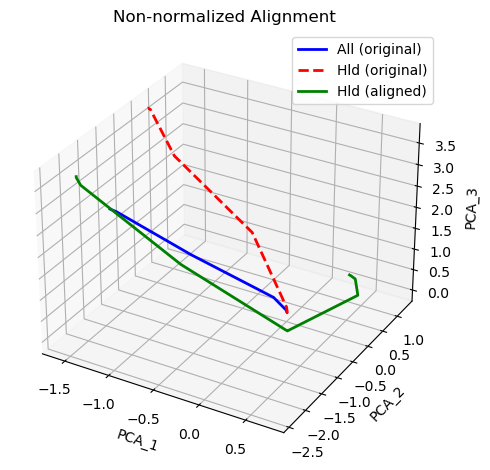

Normalized MSE: 0.29638929914355094


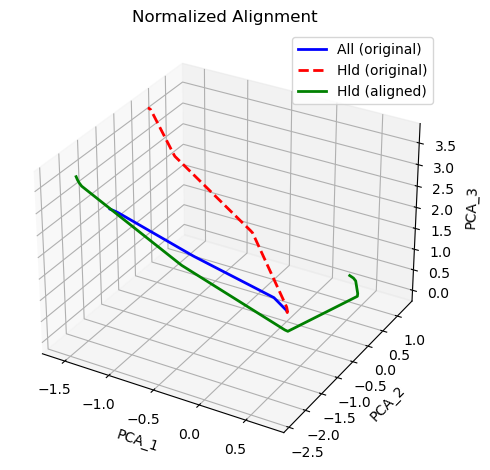

Non-normalized MSE: 1.864633891415765


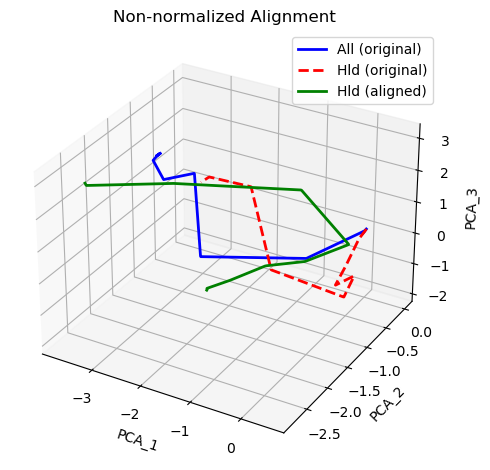

Normalized MSE: 1.895039655702933


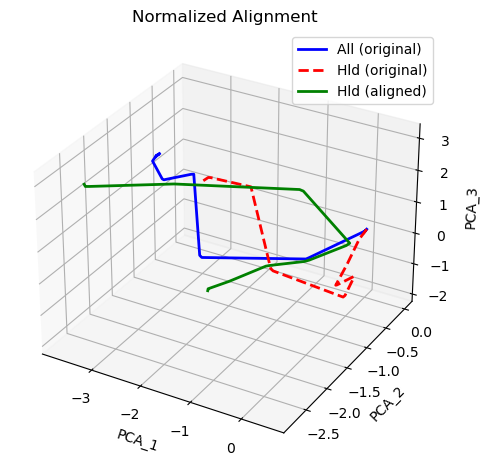

Non-normalized MSE: 0.5661659125711688


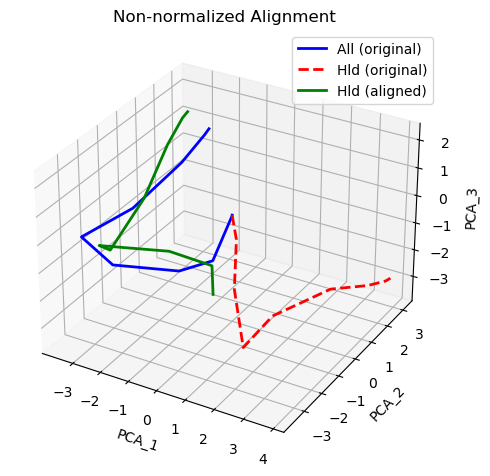

Normalized MSE: 0.5892043651843389


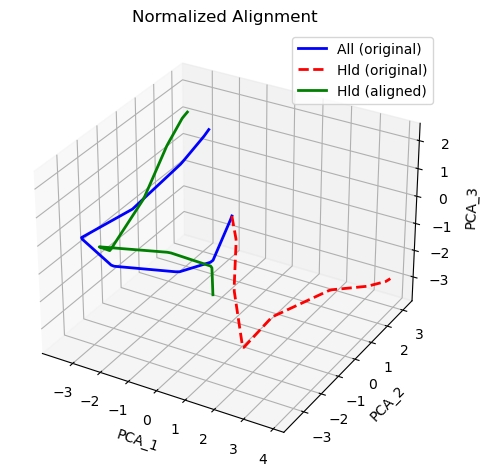

Non-normalized MSE: 0.7774620010845293


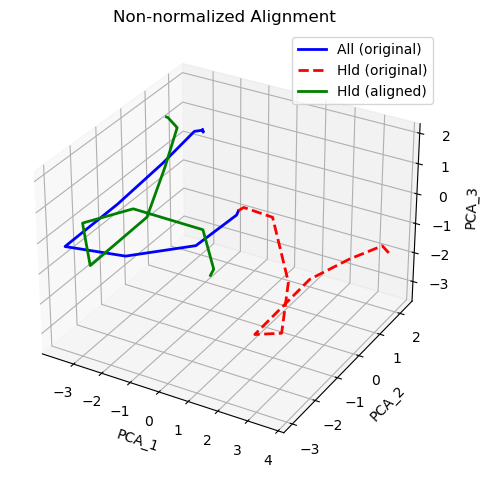

Normalized MSE: 0.7799105861600036


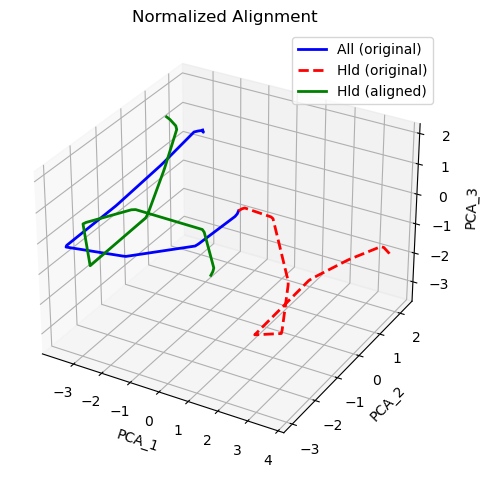

Non-normalized MSE: 3.827504339320184


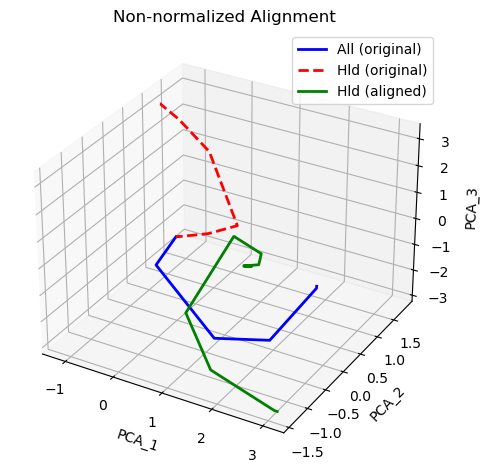

Normalized MSE: 3.869011969439797


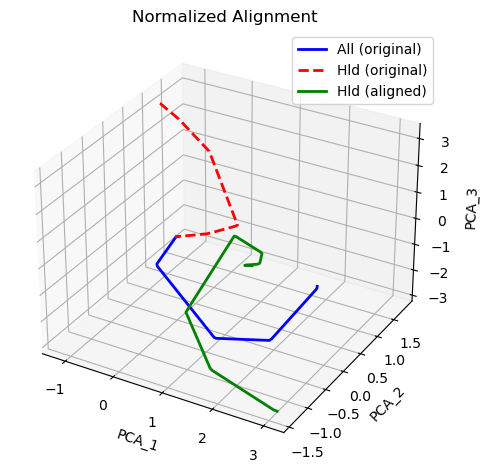

In [ ]:

import pandas as pd

# color_map from user
color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

# Assume we have splines_df loaded:
# splines_df columns: ["dataset", "perturbation", "point_index", "PCA_1", "PCA_2", "PCA_3"]
# Example: splines_df = pd.read_csv(...)

# Extract wt splines for all and hld
def extract_spline(splines_df, dataset_label, perturbation):
    sdf = splines_df[(splines_df["dataset"] == dataset_label) & (splines_df["perturbation"] == perturbation)]
    sdf = sdf.sort_values("point_index")
    points = sdf[["PCA_1", "PCA_2", "PCA_3"]].values
    return points

# Function to compute cumulative length of a 3D path
def path_length(points):
    diffs = np.diff(points, axis=0)
    segment_lengths = np.linalg.norm(diffs, axis=1)
    return np.sum(segment_lengths)

# Function to resample points along the spline so we have a consistent parameterization
def resample_spline(points, n_samples=100):
    # First compute cumulative arc length
    diffs = np.diff(points, axis=0)
    segment_lengths = np.linalg.norm(diffs, axis=1)
    cum_length = np.insert(np.cumsum(segment_lengths), 0, 0.0)
    total_length = cum_length[-1]

    # Parameterize by fraction of total length
    desired = np.linspace(0, total_length, n_samples)
    # Interpolate
    new_points = []
    for d in desired:
        # Find where this falls in cum_length
        idx = np.searchsorted(cum_length, d) - 1
        idx = max(min(idx, len(diffs)-1), 0)
        
        # fraction along the current segment
        seg_len = segment_lengths[idx] if segment_lengths[idx] != 0 else 1e-12
        alpha = (d - cum_length[idx]) / seg_len
        interp_point = points[idx] + alpha * diffs[idx]
        new_points.append(interp_point)
    return np.array(new_points)

# Normalize the length of the spline to 1 and resample to the same number of points
def normalize_spline(points, n_samples=100):
    # Total length
    total_len = path_length(points)
    # Resample to n_samples points
    resampled = resample_spline(points, n_samples=n_samples)
    # Now we can consider this normalized since it's uniformly sampled over full length
    # If we explicitly want unit length, we could scale coordinates, but usually 
    # "normalize length" means parameterizing the path from 0 to 1 in terms of arc length parameter.
    # The coordinates themselves need not be scaled, what matters is uniform parameterization.
    # If you need the entire path to literally have length 1, do:
    # resampled = resampled / total_len
    # But that changes the shape drastically.
    # For alignment tasks, we typically do not scale the path itself, just ensure equal parameterization.
    # Let's assume "normalize length" means equal parameterization. If you actually want
    # the path length = 1.0, uncomment below line:
    # resampled = resampled / total_len
    return resampled

# Kabsch algorithm to find optimal rotation (and translation) to align hld_points to all_points
# all_points and hld_points should be Nx3 numpy arrays
def kabsch_alignment(all_points, hld_points):
    # Assume both sets have the same shape
    # 1) translate both sets to their centroids
    centroid_all = np.mean(all_points, axis=0)
    centroid_hld = np.mean(hld_points, axis=0)
    A = all_points - centroid_all
    B = hld_points - centroid_hld
    
    # 2) compute SVD of A^T B
    H = A.T @ B
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T

    # ensure a right-handed coordinate system
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = Vt.T @ U.T

    # 3) compute translation
    t = centroid_all - R @ centroid_hld
    
    # return R, t so that: aligned_hld = (hld_points @ R.T) + t
    return R, t

# MSE between two sets of points
def mse(a, b):
    return np.mean(np.sum((a - b)**2, axis=1))

# Anchor by subtracting the first point from both splines so the first points align at origin
def anchor_splines(all_points, hld_points):
    anchor_all = all_points[0]
    anchor_hld = hld_points[0]
    # shift so that first points are at 0,0,0
    all_shifted = all_points - anchor_all
    hld_shifted = hld_points - anchor_hld
    return all_shifted, hld_shifted

# Plotting function in matplotlib 3D
def plot_splines_3d(all_points, hld_points, aligned_hld_points, title="Spline Comparison"):
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    
    # Plot original all (blue)
    ax.plot(all_points[:,0], all_points[:,1], all_points[:,2], label='All (original)', color='blue', linewidth=2)
    # Plot original hld (red)
    ax.plot(hld_points[:,0], hld_points[:,1], hld_points[:,2], label='Hld (original)', color='red', linestyle='--', linewidth=2)
    # Plot aligned hld (green)
    ax.plot(aligned_hld_points[:,0], aligned_hld_points[:,1], aligned_hld_points[:,2], label='Hld (aligned)', color='green', linewidth=2)
    
    ax.set_xlabel('PCA_1')
    ax.set_ylabel('PCA_2')
    ax.set_zlabel('PCA_3')
    ax.set_title(title)
    ax.legend()
    plt.tight_layout()
    plt.show()


wnt-i
Non-normalized MSE: 0.027887668879374664


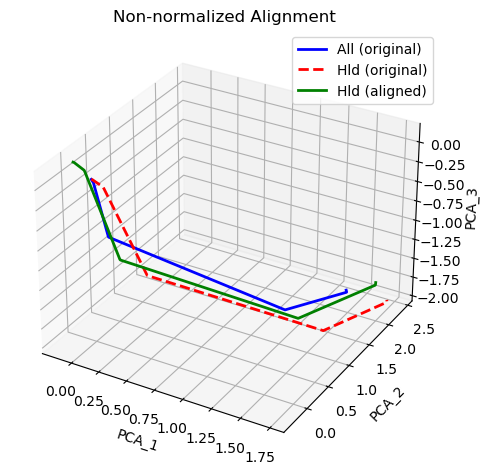

Normalized MSE: 0.028145672507354745


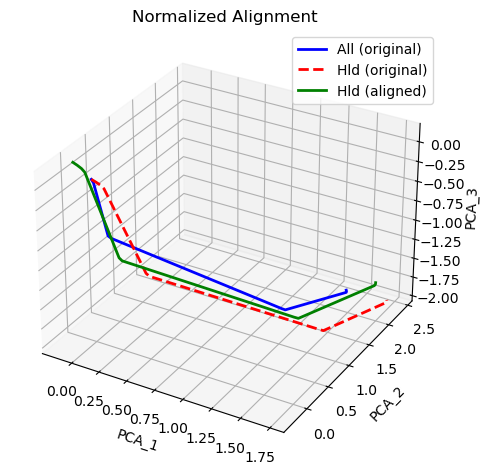

tgfb-i
Non-normalized MSE: 0.05074210135509817


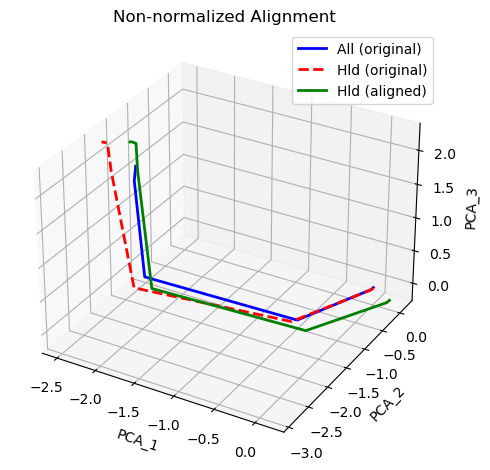

Normalized MSE: 0.05066354542162614


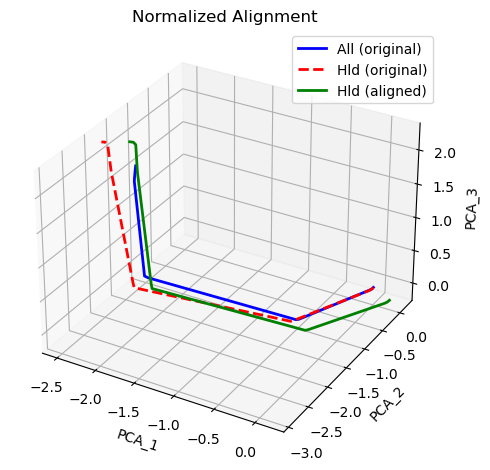

wt
Non-normalized MSE: 0.06625775795605768


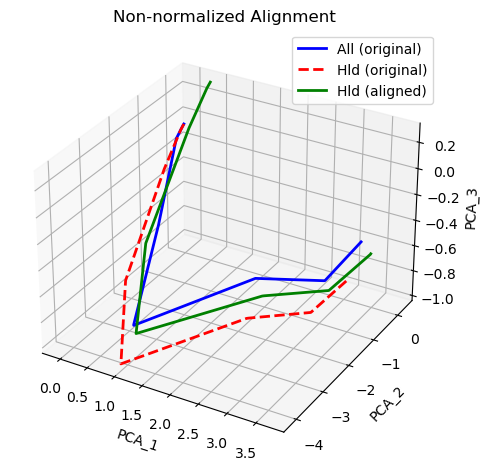

Normalized MSE: 0.067508779565436


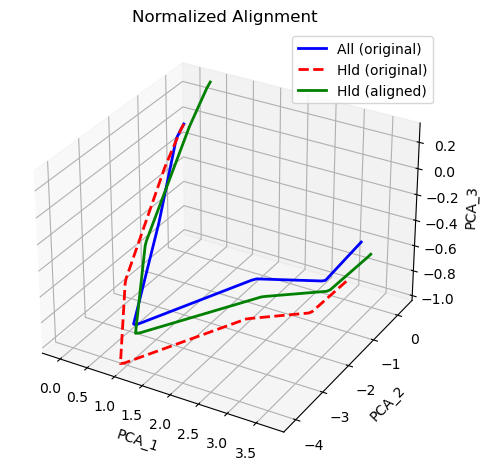

lmx1b
Non-normalized MSE: 0.832645326101213


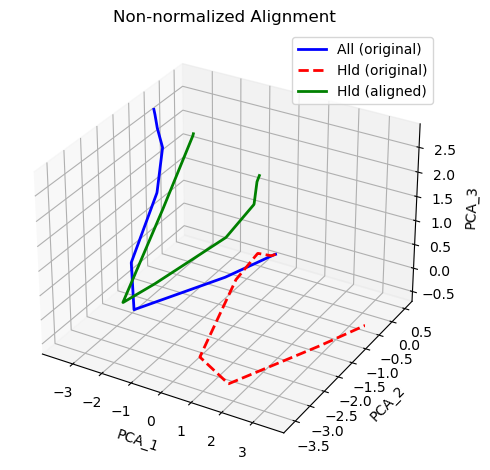

Normalized MSE: 0.8680350427951492


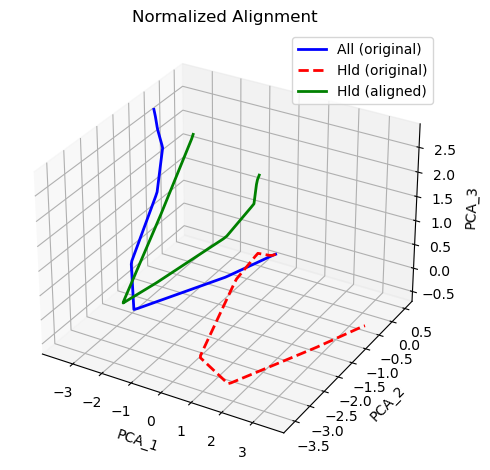

gdf3
Non-normalized MSE: 0.07338135099151523


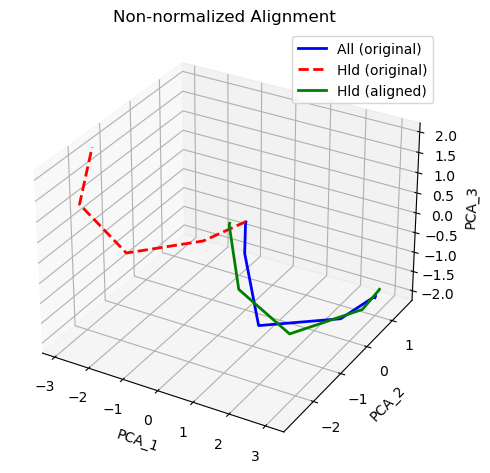

Normalized MSE: 0.0733544728369494


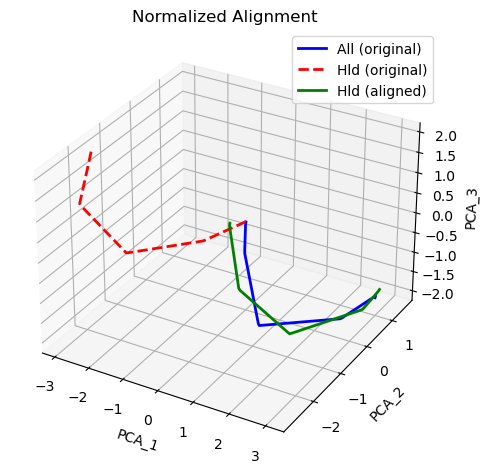

In [37]:

splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_71.csv")

    # Main experiment:
for pert in unique_perts:  # we focus on wt as requested
    print(pert)
    all_wt = extract_spline(splines_df, "all", pert)
    hld_wt = extract_spline(splines_df, "hld", pert)

    # Ensure same number of points for fair comparison in MSE
    # Choose a number of points (e.g., the min length or a standard number)
    n_points = min(len(all_wt), len(hld_wt))
    all_wt_resampled = resample_spline(all_wt, n_points)
    hld_wt_resampled = resample_spline(hld_wt, n_points)

    # 1) Without normalization
    all_anchored, hld_anchored = anchor_splines(all_wt_resampled, hld_wt_resampled)
    R, t = kabsch_alignment(all_anchored, hld_anchored)
    hld_aligned = (hld_anchored @ R.T) + t
    non_norm_mse = mse(all_anchored, hld_aligned)

    print("Non-normalized MSE:", non_norm_mse)

    plot_splines_3d(all_anchored, hld_anchored, hld_aligned, title="Non-normalized Alignment")

    # 2) With normalization
    # We'll normalize both splines by re-parameterizing them along their length
    # Let's pick a standard number of points for normalized version, say 100.
    n_norm = 100
    all_norm = normalize_spline(all_wt, n_samples=n_norm)
    hld_norm = normalize_spline(hld_wt, n_samples=n_norm)

    all_norm_anchored, hld_norm_anchored = anchor_splines(all_norm, hld_norm)
    R_norm, t_norm = kabsch_alignment(all_norm_anchored, hld_norm_anchored)
    hld_norm_aligned = (hld_norm_anchored @ R_norm.T) + t_norm
    norm_mse = mse(all_norm_anchored, hld_norm_aligned)

    print("Normalized MSE:", norm_mse)

    plot_splines_3d(all_norm_anchored, hld_norm_anchored, hld_norm_aligned, title="Normalized Alignment")


In [42]:

import plotly.graph_objects as go

# Assuming splines_df already loaded with columns:
# ["dataset", "perturbation", "point_index", "PCA_1", "PCA_2", "PCA_3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

def extract_spline(splines_df, dataset_label, perturbation):
    sdf = splines_df[(splines_df["dataset"] == dataset_label) & (splines_df["perturbation"] == perturbation)]
    sdf = sdf.sort_values("point_index")
    points = sdf[["PCA_1", "PCA_2", "PCA_3"]].values
    return points

def resample_spline(points, n_samples=100):
    diffs = np.diff(points, axis=0)
    segment_lengths = np.linalg.norm(diffs, axis=1)
    cum_length = np.insert(np.cumsum(segment_lengths), 0, 0.0)
    total_length = cum_length[-1]

    desired = np.linspace(0, total_length, n_samples)
    new_points = []
    for d in desired:
        idx = np.searchsorted(cum_length, d) - 1
        idx = max(min(idx, len(diffs)-1), 0)
        seg_len = segment_lengths[idx] if segment_lengths[idx] != 0 else 1e-12
        alpha = (d - cum_length[idx]) / seg_len
        interp_point = points[idx] + alpha * diffs[idx]
        new_points.append(interp_point)
    return np.array(new_points)

def kabsch_alignment(P, Q):
    # Kabsch alignment to find rotation & translation minimizing RMSD between P and Q
    # P and Q are Nx3 sets of points
    centroid_P = np.mean(P, axis=0)
    centroid_Q = np.mean(Q, axis=0)
    P_centered = P - centroid_P
    Q_centered = Q - centroid_Q

    H = P_centered.T @ Q_centered
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T
    # Correct any reflection
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = Vt.T @ U.T

    t = centroid_P - R @ centroid_Q
    return R, t

perturbations = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
fig = go.Figure()

for pert in perturbations:
    all_points = extract_spline(splines_df, "all", pert)
    hld_points = extract_spline(splines_df, "hld", pert)
    
    # Resample so they have the same number of points
    min_len = min(len(all_points), len(hld_points))
    all_resampled = resample_spline(all_points, min_len)
    hld_resampled = resample_spline(hld_points, min_len)
    
    # Use the first point of the ALL spline as the universal anchor
    anchor_all = all_resampled[0].copy()
    # Shift both splines so that the first ALL point is at the origin
    all_anchored = all_resampled - anchor_all
    hld_anchored = hld_resampled - anchor_all
    
    # Align hld_anchored to all_anchored using Kabsch
    R, t = kabsch_alignment(all_anchored, hld_anchored)
    hld_aligned = (hld_anchored @ R.T) + t
    
    # Transform back to the original coordinate system by adding anchor_all
    all_original = all_anchored + anchor_all
    hld_original = hld_anchored + anchor_all
    hld_aligned_original = hld_aligned + anchor_all
    
    c = color_map[pert]
    
    # Plot all (original)
    fig.add_trace(go.Scatter3d(
        x=all_original[:,0],
        y=all_original[:,1],
        z=all_original[:,2],
        mode='lines',
        line=dict(color=c, width=4),
        name=f"{pert} (all original)"
    ))
    
    # Plot hld (original)
    fig.add_trace(go.Scatter3d(
        x=hld_original[:,0],
        y=hld_original[:,1],
        z=hld_original[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dash'),
        name=f"{pert} (hld original)"
    ))
    
    # Plot hld (aligned)
    fig.add_trace(go.Scatter3d(
        x=hld_aligned_original[:,0],
        y=hld_aligned_original[:,1],
        z=hld_aligned_original[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dot'),
        name=f"{pert} (hld aligned)"
    ))

fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="Comparison of 'all', 'hld', and 'hld_aligned' Splines for Each Perturbation"
)

fig.show()


In [45]:
import numpy as np
import plotly.graph_objects as go
from scipy.spatial.distance import cdist

# Assume splines_df is loaded as before
# Columns: ["dataset", "perturbation", "point_index", "PCA_1", "PCA_2", "PCA_3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

def extract_spline(splines_df, dataset_label, perturbation):
    sdf = splines_df[(splines_df["dataset"] == dataset_label) & (splines_df["perturbation"] == perturbation)]
    sdf = sdf.sort_values("point_index")
    points = sdf[["PCA_1", "PCA_2", "PCA_3"]].values
    return points

def resample_spline(points, n_samples=100):
    diffs = np.diff(points, axis=0)
    segment_lengths = np.linalg.norm(diffs, axis=1)
    cum_length = np.insert(np.cumsum(segment_lengths), 0, 0.0)
    total_length = cum_length[-1]

    desired = np.linspace(0, total_length, n_samples)
    new_points = []
    for d in desired:
        idx = np.searchsorted(cum_length, d) - 1
        idx = max(min(idx, len(diffs)-1), 0)
        seg_len = segment_lengths[idx] if segment_lengths[idx] != 0 else 1e-12
        alpha = (d - cum_length[idx]) / seg_len
        interp_point = points[idx] + alpha * diffs[idx]
        new_points.append(interp_point)
    return np.array(new_points)

def kabsch_alignment(P, Q):
    """Kabsch alignment: returns R, t."""
    centroid_P = np.mean(P, axis=0)
    centroid_Q = np.mean(Q, axis=0)
    P_centered = P - centroid_P
    Q_centered = Q - centroid_Q

    H = P_centered.T @ Q_centered
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = Vt.T @ U.T
    t = centroid_P - R @ centroid_Q
    return R, t

def procrustes_alignment(P, Q, allow_scaling=True):
    """Procrustes alignment: returns R, t, s."""
    centroid_P = np.mean(P, axis=0)
    centroid_Q = np.mean(Q, axis=0)
    P_centered = P - centroid_P
    Q_centered = Q - centroid_Q

    norm_P = np.linalg.norm(P_centered)
    norm_Q = np.linalg.norm(Q_centered)
    if allow_scaling and norm_Q > 1e-12:
        s = norm_P / norm_Q
    else:
        s = 1.0
    Q_scaled = Q_centered * s

    H = P_centered.T @ Q_scaled
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = Vt.T @ U.T
    t = centroid_P - R @ (centroid_Q * s)
    return R, t, s

def icp(P, Q, max_iter=20, tol=1e-6):
    """Simple ICP using Kabsch for updates, assuming direct index-to-index correspondences.
       In this case, since P and Q are parameterized and correspond, ICP will basically just do Kabsch once.
       But we'll run it iteratively to show the concept."""
    P_current = P.copy()
    Q_current = Q.copy()

    prev_error = np.inf
    for i in range(max_iter):
        # In a typical ICP scenario, you'd find closest points here. 
        # Since we assume equal parameterization, let's just pair points by index.
        
        R, t = kabsch_alignment(P_current, Q_current)
        Q_aligned = (Q_current @ R.T) + t
        error = np.mean(np.linalg.norm(P_current - Q_aligned, axis=1)**2)
        
        if np.abs(prev_error - error) < tol:
            # Converged
            return Q_aligned, R, t
        prev_error = error
        Q_current = Q_aligned
    return Q_current, R, t

def dtw_path(P, Q):
    """Compute DTW path between two curves using Euclidean distance.
       Returns path as a list of (i,j) matches."""
    dist_matrix = cdist(P, Q, 'euclidean')
    n, m = dist_matrix.shape
    DTW = np.zeros((n+1, m+1)) + np.inf
    DTW[0,0] = 0

    for i in range(1, n+1):
        for j in range(1, m+1):
            cost = dist_matrix[i-1,j-1]
            DTW[i,j] = cost + min(DTW[i-1,j], DTW[i,j-1], DTW[i-1,j-1])
    
    # Backtrack to find path
    path = []
    i, j = n, m
    while i>0 and j>0:
        path.append((i-1, j-1))
        steps = [(DTW[i-1,j], i-1, j), (DTW[i,j-1], i, j-1), (DTW[i-1,j-1], i-1, j-1)]
        cost, i2, j2 = min(steps, key=lambda x: x[0])
        i, j = i2, j2
    path.reverse()
    return path

def apply_alignment(P, Q, method="kabsch"):
    """Apply specified alignment method: kabsch or procrustes."""
    if method == "kabsch":
        R, t = kabsch_alignment(P, Q)
        Q_aligned = (Q @ R.T) + t
        return Q_aligned
    elif method == "procrustes":
        R, t, s = procrustes_alignment(P, Q, allow_scaling=True)
        Q_aligned = ((Q - np.mean(Q, axis=0)) * s) @ R.T + t
        return Q_aligned
    else:
        raise ValueError("Unknown method")

perturbations = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
fig = go.Figure()

for pert in perturbations:
    all_points = extract_spline(splines_df, "all", pert)
    hld_points = extract_spline(splines_df, "hld", pert)
    
    # Resample so they have same number of points for initial methods
    n_points = min(len(all_points), len(hld_points))
    all_resampled = resample_spline(all_points, n_points)
    hld_resampled = resample_spline(hld_points, n_points)

    # Kabsch
    R_kab, t_kab = kabsch_alignment(all_resampled, hld_resampled)
    hld_kab_aligned = (hld_resampled @ R_kab.T) + t_kab

    # Procrustes
    R_proc, t_proc, s_proc = procrustes_alignment(all_resampled, hld_resampled, allow_scaling=True)
    hld_proc_aligned = ((hld_resampled - np.mean(hld_resampled, axis=0)) * s_proc) @ R_proc.T + t_proc

    # ICP
    hld_icp_aligned, R_icp, t_icp = icp(all_resampled, hld_resampled, max_iter=20, tol=1e-7)

    # DTW + Kabsch:
    # Find DTW path to get correspondence
    path = dtw_path(all_resampled, hld_resampled)
    # Extract matched points
    all_matched = np.array([all_resampled[i] for i,j in path])
    hld_matched = np.array([hld_resampled[j] for i,j in path])
    # Now align hld_matched to all_matched using Kabsch
    R_dtw, t_dtw = kabsch_alignment(all_matched, hld_matched)
    hld_dtw_aligned = (hld_resampled @ R_dtw.T) + t_dtw

    c = color_map[pert]

    # Plot original all
    fig.add_trace(go.Scatter3d(
        x=all_resampled[:,0],
        y=all_resampled[:,1],
        z=all_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4),
        name=f"{pert} all (original)"
    ))

    # Plot original hld
    fig.add_trace(go.Scatter3d(
        x=hld_resampled[:,0],
        y=hld_resampled[:,1],
        z=hld_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dash'),
        name=f"{pert} hld (original)"
    ))
    
    # Plot Kabsch aligned
    fig.add_trace(go.Scatter3d(
        x=hld_kab_aligned[:,0],
        y=hld_kab_aligned[:,1],
        z=hld_kab_aligned[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dot'),
        name=f"{pert} hld (Kabsch)"
    ))

    # Plot Procrustes aligned
    fig.add_trace(go.Scatter3d(
        x=hld_proc_aligned[:,0],
        y=hld_proc_aligned[:,1],
        z=hld_proc_aligned[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='longdash'),
        name=f"{pert} hld (Procrustes)"
    ))

    # Plot ICP aligned
    fig.add_trace(go.Scatter3d(
        x=hld_icp_aligned[:,0],
        y=hld_icp_aligned[:,1],
        z=hld_icp_aligned[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dashdot'),
        name=f"{pert} hld (ICP)"
    ))
    
    # Plot DTW+Kabsch aligned
    fig.add_trace(go.Scatter3d(
        x=hld_dtw_aligned[:,0],
        y=hld_dtw_aligned[:,1],
        z=hld_dtw_aligned[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='longdashdot'),
        name=f"{pert} hld (DTW+Kabsch)"
    ))

fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="Alignment Comparison: Kabsch, Procrustes, ICP, DTW+Kabsch"
)

fig.show()


In [56]:

import pandas as pd
import plotly.graph_objects as go

# Assuming splines_df is already loaded
# Columns: ["dataset", "perturbation", "point_index", "PCA_1", "PCA_2", "PCA_3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

def extract_spline(splines_df, dataset_label, perturbation):
    sdf = splines_df[(splines_df["dataset"] == dataset_label) & (splines_df["perturbation"] == perturbation)]
    sdf = sdf.sort_values("point_index")
    points = sdf[["PCA_1", "PCA_2", "PCA_3"]].values
    return points

def resample_spline(points, n_samples=100):
    diffs = np.diff(points, axis=0)
    segment_lengths = np.linalg.norm(diffs, axis=1)
    cum_length = np.insert(np.cumsum(segment_lengths), 0, 0.0)
    total_length = cum_length[-1]

    desired = np.linspace(0, total_length, n_samples)
    new_points = []
    for d in desired:
        idx = np.searchsorted(cum_length, d) - 1
        idx = max(min(idx, len(diffs)-1), 0)
        seg_len = segment_lengths[idx] if segment_lengths[idx] != 0 else 1e-12
        alpha = (d - cum_length[idx]) / seg_len
        interp_point = points[idx] + alpha * diffs[idx]
        new_points.append(interp_point)
    return np.array(new_points)

def kabsch_alignment(P, Q):
    # P and Q are Nx3 arrays
    # 1. Compute centroids
    centroid_P = np.mean(P, axis=0)
    centroid_Q = np.mean(Q, axis=0)
    # 2. Center the points
    P_centered = P - centroid_P
    Q_centered = Q - centroid_Q
    # 3. Compute rotation using SVD
    H = P_centered.T @ Q_centered
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T
    # Correct for reflection
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = Vt.T @ U.T
    # 4. Compute translation
    t = centroid_P - R @ centroid_Q

    # Return the rotation and translation
    return R, t

def rmse(a, b):
    return np.sqrt(np.mean((a - b)**2))

def mean_l1_error(a, b):
# a and b are Nx3 arrays of points.
# Compute L1 distance for each point pair: sum of absolute differences across coordinates
# Then take the mean over all points.
    return np.mean(np.sum(np.abs(a - b), axis=1))

# Example usage:
splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_77.csv")
# splines_df_71 = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_71.csv")


perturbations = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
fig = go.Figure()

for pert in perturbations:
    all_points = extract_spline(splines_df, "all", pert)
    hld_points = extract_spline(splines_df, "hld", pert)
    
    # Resample so they have the same number of points
    min_len = min(len(all_points), len(hld_points))
    all_resampled = resample_spline(all_points, min_len)
    hld_resampled = resample_spline(hld_points, min_len)
    
    # Compute initial RMSE before alignment
    initial_rmse = rmse(all_resampled, hld_resampled)
    
    # Perform Kabsch alignment
    R, t = kabsch_alignment(all_resampled, hld_resampled)
    
    hld_aligned = (hld_resampled @ R.T) + t
    
    # Compute RMSE after alignment
    aligned_rmse = rmse(all_resampled, hld_aligned)

    initial_error = mean_l1_error(all_resampled, hld_resampled)
    aligned_error = mean_l1_error(all_resampled, hld_aligned)
    print(f"Perturbation: {pert}")
    print(f"Initial RMSE: {initial_rmse:.4f}")
    print(f"Aligned RMSE: {aligned_rmse:.4f}")
    print(f"Initial MSE: {initial_error:.4f}")
    print(f"Aligned MSE: {aligned_error:.4f}")
    
    
    # Ensure we keep the original coordinate system (we did not alter the original sets 
    # except for resampling). Both all_resampled and hld_aligned are now in the original 
    # coordinate frame of the 'all' data (since we didn't anchor by first point).
    # The alignment ensures hld_aligned best matches all_resampled in the original frame.
    
    c = color_map[pert]
    
    # Plot all (original)
    fig.add_trace(go.Scatter3d(
        x=all_resampled[:,0],
        y=all_resampled[:,1],
        z=all_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4),
        name=f"{pert} (all original)"
    ))
    
    # Plot hld (original)
    fig.add_trace(go.Scatter3d(
        x=hld_resampled[:,0],
        y=hld_resampled[:,1],
        z=hld_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dash'),
        name=f"{pert} (hld original)"
    ))
    
    # Plot hld (aligned)
    fig.add_trace(go.Scatter3d(
        x=hld_aligned[:,0],
        y=hld_aligned[:,1],
        z=hld_aligned[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dot'),
        name=f"{pert} (hld aligned)"
    ))

fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="Comparison of 'all', 'hld', and 'hld_aligned' Splines for Each Perturbation (No Anchoring)"
)

fig.write_html(os.path.join(save_dir, f"corrected_splines_77.html"))
fig.show()

Perturbation: wnt-i
Initial RMSE: 2.2123
Aligned RMSE: 0.3115
Initial MSE: 6.0521
Aligned MSE: 0.7575
Perturbation: tgfb-i
Initial RMSE: 1.5800
Aligned RMSE: 0.7884
Initial MSE: 4.2344
Aligned MSE: 1.6620
Perturbation: wt
Initial RMSE: 1.7503
Aligned RMSE: 0.4344
Initial MSE: 4.2322
Aligned MSE: 0.9416
Perturbation: lmx1b
Initial RMSE: 1.6178
Aligned RMSE: 0.5091
Initial MSE: 4.0943
Aligned MSE: 1.2352
Perturbation: gdf3
Initial RMSE: 1.9100
Aligned RMSE: 1.1295
Initial MSE: 4.6791
Aligned MSE: 2.7214


In [57]:

import pandas as pd
import plotly.graph_objects as go

# Assuming splines_df is already loaded
# Columns: ["dataset", "perturbation", "point_index", "PCA_1", "PCA_2", "PCA_3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

def extract_spline(splines_df, dataset_label, perturbation):
    sdf = splines_df[(splines_df["dataset"] == dataset_label) & (splines_df["perturbation"] == perturbation)]
    sdf = sdf.sort_values("point_index")
    points = sdf[["PCA_1", "PCA_2", "PCA_3"]].values
    return points

def resample_spline(points, n_samples=100):
    diffs = np.diff(points, axis=0)
    segment_lengths = np.linalg.norm(diffs, axis=1)
    cum_length = np.insert(np.cumsum(segment_lengths), 0, 0.0)
    total_length = cum_length[-1]

    desired = np.linspace(0, total_length, n_samples)
    new_points = []
    for d in desired:
        idx = np.searchsorted(cum_length, d) - 1
        idx = max(min(idx, len(diffs)-1), 0)
        seg_len = segment_lengths[idx] if segment_lengths[idx] != 0 else 1e-12
        alpha = (d - cum_length[idx]) / seg_len
        interp_point = points[idx] + alpha * diffs[idx]
        new_points.append(interp_point)
    return np.array(new_points)

def kabsch_alignment(P, Q):
    # P and Q are Nx3 arrays
    # 1. Compute centroids
    centroid_P = np.mean(P, axis=0)
    centroid_Q = np.mean(Q, axis=0)
    # 2. Center the points
    P_centered = P - centroid_P
    Q_centered = Q - centroid_Q
    # 3. Compute rotation using SVD
    H = P_centered.T @ Q_centered
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T
    # Correct for reflection
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = Vt.T @ U.T
    # 4. Compute translation
    t = centroid_P - R @ centroid_Q

    # Return the rotation and translation
    return R, t

def rmse(a, b):
    return np.sqrt(np.mean((a - b)**2))

def mean_l1_error(a, b):
# a and b are Nx3 arrays of points.
# Compute L1 distance for each point pair: sum of absolute differences across coordinates
# Then take the mean over all points.
    return np.mean(np.sum(np.abs(a - b), axis=1))

# Example usage:
# splines_df_77 = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_77.csv")
splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_71.csv")


perturbations = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
fig = go.Figure()

for pert in perturbations:
    all_points = extract_spline(splines_df, "all", pert)
    hld_points = extract_spline(splines_df, "hld", pert)
    
    # Resample so they have the same number of points
    min_len = min(len(all_points), len(hld_points))
    all_resampled = resample_spline(all_points, min_len)
    hld_resampled = resample_spline(hld_points, min_len)
    
    # Compute initial RMSE before alignment
    initial_rmse = rmse(all_resampled, hld_resampled)
    
    # Perform Kabsch alignment
    R, t = kabsch_alignment(all_resampled, hld_resampled)
    
    hld_aligned = (hld_resampled @ R.T) + t
    
    # Compute RMSE after alignment
    aligned_rmse = rmse(all_resampled, hld_aligned)

    initial_error = mean_l1_error(all_resampled, hld_resampled)
    aligned_error = mean_l1_error(all_resampled, hld_aligned)
    print(f"Perturbation: {pert}")
    print(f"Initial RMSE: {initial_rmse:.4f}")
    print(f"Aligned RMSE: {aligned_rmse:.4f}")
    print(f"Initial MSE: {initial_error:.4f}")
    print(f"Aligned MSE: {aligned_error:.4f}")
    
    
    # Ensure we keep the original coordinate system (we did not alter the original sets 
    # except for resampling). Both all_resampled and hld_aligned are now in the original 
    # coordinate frame of the 'all' data (since we didn't anchor by first point).
    # The alignment ensures hld_aligned best matches all_resampled in the original frame.
    
    c = color_map[pert]
    
    # Plot all (original)
    fig.add_trace(go.Scatter3d(
        x=all_resampled[:,0],
        y=all_resampled[:,1],
        z=all_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4),
        name=f"{pert} (all original)"
    ))
    
    # Plot hld (original)
    fig.add_trace(go.Scatter3d(
        x=hld_resampled[:,0],
        y=hld_resampled[:,1],
        z=hld_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dash'),
        name=f"{pert} (hld original)"
    ))
    
    # Plot hld (aligned)
    fig.add_trace(go.Scatter3d(
        x=hld_aligned[:,0],
        y=hld_aligned[:,1],
        z=hld_aligned[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dot'),
        name=f"{pert} (hld aligned)"
    ))

fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="Comparison of 'all', 'hld', and 'hld_aligned' Splines for Each Perturbation (No Anchoring)"
)

fig.write_html(os.path.join(save_dir, f"corrected_splines_71.html"))
fig.show()


Perturbation: wnt-i
Initial RMSE: 0.1069
Aligned RMSE: 0.0964
Initial MSE: 0.2406
Aligned MSE: 0.2455
Perturbation: tgfb-i
Initial RMSE: 0.1437
Aligned RMSE: 0.1301
Initial MSE: 0.3121
Aligned MSE: 0.3187
Perturbation: wt
Initial RMSE: 0.1263
Aligned RMSE: 0.1486
Initial MSE: 0.2925
Aligned MSE: 0.3780
Perturbation: lmx1b
Initial RMSE: 1.7026
Aligned RMSE: 0.5268
Initial MSE: 3.7063
Aligned MSE: 1.0507
Perturbation: gdf3
Initial RMSE: 1.4560
Aligned RMSE: 0.1564
Initial MSE: 3.6879
Aligned MSE: 0.3728


In [60]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import os

# Assuming splines_df is already loaded
# Columns: ["dataset", "perturbation", "point_index", "PCA_1", "PCA_2", "PCA_3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

def extract_spline(splines_df, dataset_label, perturbation):
    sdf = splines_df[(splines_df["dataset"] == dataset_label) & (splines_df["perturbation"] == perturbation)]
    sdf = sdf.sort_values("point_index")
    points = sdf[["PCA_1", "PCA_2", "PCA_3"]].values
    return points

def resample_spline(points, n_samples=100):
    diffs = np.diff(points, axis=0)
    segment_lengths = np.linalg.norm(diffs, axis=1)
    cum_length = np.insert(np.cumsum(segment_lengths), 0, 0.0)
    total_length = cum_length[-1]

    desired = np.linspace(0, total_length, n_samples)
    new_points = []
    for d in desired:
        idx = np.searchsorted(cum_length, d) - 1
        idx = max(min(idx, len(diffs)-1), 0)
        seg_len = segment_lengths[idx] if segment_lengths[idx] != 0 else 1e-12
        alpha = (d - cum_length[idx]) / seg_len
        interp_point = points[idx] + alpha * diffs[idx]
        new_points.append(interp_point)
    return np.array(new_points)

def kabsch_alignment(P, Q):
    # P and Q are Nx3 arrays
    # 1. Compute centroids
    centroid_P = np.mean(P, axis=0)
    centroid_Q = np.mean(Q, axis=0)
    # 2. Center the points
    P_centered = P - centroid_P
    Q_centered = Q - centroid_Q
    # 3. Compute rotation using SVD
    H = P_centered.T @ Q_centered
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T
    # Correct for reflection
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = Vt.T @ U.T
    # 4. Compute translation
    t = centroid_P - R @ centroid_Q

    # Return the rotation and translation
    return R, t

def rmse(a, b):
    return np.sqrt(np.mean((a - b)**2))

def mean_l1_error(a, b):
    return np.mean(np.sum(np.abs(a - b), axis=1))

# Example usage:
# splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_77.csv")
splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_71.csv")

perturbations = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]

# First, we build the scaffold:
# We'll store all_resampled and hld_resampled for each perturbation, 
# and also collect them into big arrays for scaffold alignment.
all_resampled_dict = {}
hld_resampled_dict = {}
min_len_per_pert = {}

for pert in perturbations:
    all_points = extract_spline(splines_df, "all", pert)
    hld_points = extract_spline(splines_df, "hld", pert)
    
    # Determine min length for this pert to ensure equal number of points
    min_len = min(len(all_points), len(hld_points))
    min_len_per_pert[pert] = min_len
    all_resampled = resample_spline(all_points, min_len)
    hld_resampled = resample_spline(hld_points, min_len)
    
    all_resampled_dict[pert] = all_resampled
    hld_resampled_dict[pert] = hld_resampled

# Combine all perturbations into one big scaffold
all_combined = np.concatenate([all_resampled_dict[pert] for pert in perturbations], axis=0)
hld_combined = np.concatenate([hld_resampled_dict[pert] for pert in perturbations], axis=0)

# Perform a single Kabsch alignment on the entire scaffold
R, t = kabsch_alignment(all_combined, hld_combined)
hld_combined_aligned = (hld_combined @ R.T) + t

# Compute overall scaffold errors
initial_scaffold_rmse = rmse(all_combined, hld_combined)
aligned_scaffold_rmse = rmse(all_combined, hld_combined_aligned)

initial_scaffold_l1 = mean_l1_error(all_combined, hld_combined)
aligned_scaffold_l1 = mean_l1_error(all_combined, hld_combined_aligned)

print("Scaffold initial RMSE:", initial_scaffold_rmse)
print("Scaffold aligned RMSE:", aligned_scaffold_rmse)
print("Scaffold initial L1:", initial_scaffold_l1)
print("Scaffold aligned L1:", aligned_scaffold_l1)

# Now, apply the same R and t to each perturbation's hld and calculate individual errors
fig = go.Figure()

start_idx = 0
for pert in perturbations:
    length = min_len_per_pert[pert]
    # Indices for this perturbation in the scaffold arrays
    end_idx = start_idx + length
    
    all_resampled = all_resampled_dict[pert]
    hld_resampled = hld_resampled_dict[pert]
    
    # Extract the portion from the aligned big array
    hld_aligned = (hld_resampled @ R.T) + t

    # Compute per-perturbation errors
    initial_rmse = rmse(all_resampled, hld_resampled)
    aligned_rmse = rmse(all_resampled, hld_aligned)
    initial_l1 = mean_l1_error(all_resampled, hld_resampled)
    aligned_l1 = mean_l1_error(all_resampled, hld_aligned)
    
    print(f"Perturbation: {pert}")
    print(f"  Initial RMSE: {initial_rmse:.4f}, Aligned RMSE: {aligned_rmse:.4f}")
    print(f"  Initial L1: {initial_l1:.4f}, Aligned L1: {aligned_l1:.4f}")
    
    c = color_map[pert]
    
    # Plot all (original)
    fig.add_trace(go.Scatter3d(
        x=all_resampled[:,0],
        y=all_resampled[:,1],
        z=all_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4),
        name=f"{pert} (all original)"
    ))
    
    # Plot hld (original)
    fig.add_trace(go.Scatter3d(
        x=hld_resampled[:,0],
        y=hld_resampled[:,1],
        z=hld_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dash'),
        name=f"{pert} (hld original)"
    ))
    
    # Plot hld (aligned)
    fig.add_trace(go.Scatter3d(
        x=hld_aligned[:,0],
        y=hld_aligned[:,1],
        z=hld_aligned[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dot'),
        name=f"{pert} (hld aligned)"
    ))
    
    start_idx = end_idx

fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="Scaffold Alignment of All Perturbations"
)

fig.write_html(os.path.join(save_dir, f"alignonscaffold_splines_71.html"))
fig.show()



Scaffold initial RMSE: 1.0066478462177357
Scaffold aligned RMSE: 1.019125727823634
Scaffold initial L1: 1.64787486014399
Scaffold aligned L1: 1.8590862521498275
Perturbation: wnt-i
  Initial RMSE: 0.1069, Aligned RMSE: 0.1601
  Initial L1: 0.2406, Aligned L1: 0.3627
Perturbation: tgfb-i
  Initial RMSE: 0.1437, Aligned RMSE: 0.2289
  Initial L1: 0.3121, Aligned L1: 0.5150
Perturbation: wt
  Initial RMSE: 0.1263, Aligned RMSE: 0.2876
  Initial L1: 0.2925, Aligned L1: 0.7070
Perturbation: lmx1b
  Initial RMSE: 1.7026, Aligned RMSE: 1.7109
  Initial L1: 3.7063, Aligned L1: 3.9830
Perturbation: gdf3
  Initial RMSE: 1.4560, Aligned RMSE: 1.4509
  Initial L1: 3.6879, Aligned L1: 3.7276


In [62]:
# Example usage:
# splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_77.csv")
splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_71.csv")


perturbations = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
fig = go.Figure()

# We'll also compute overall scaffold errors here for comparison.
all_combined = []
hld_combined = []
hld_aligned_combined = []

for pert in perturbations:
    all_points = extract_spline(splines_df, "all", pert)
    hld_points = extract_spline(splines_df, "hld", pert)
    
    # Resample so they have the same number of points
    min_len = min(len(all_points), len(hld_points))
    all_resampled = resample_spline(all_points, min_len)
    hld_resampled = resample_spline(hld_points, min_len)
    
    # Compute initial errors before alignment
    initial_rmse = rmse(all_resampled, hld_resampled)
    initial_l1 = mean_l1_error(all_resampled, hld_resampled)

    # Perform Kabsch alignment
    R, t = kabsch_alignment(all_resampled, hld_resampled)
    hld_aligned = (hld_resampled @ R.T) + t
    
    # Compute errors after alignment
    aligned_rmse = rmse(all_resampled, hld_aligned)
    aligned_l1 = mean_l1_error(all_resampled, hld_aligned)
    
    # Print in the organized format
    print(f"Perturbation: {pert}")
    print(f"  Initial RMSE: {initial_rmse:.4f}, Aligned RMSE: {aligned_rmse:.4f}")
    print(f"  Initial L1:   {initial_l1:.4f}, Aligned L1:   {aligned_l1:.4f}")
    
    # Accumulate for scaffold comparison if desired
    all_combined.append(all_resampled)
    hld_combined.append(hld_resampled)
    hld_aligned_combined.append(hld_aligned)
    
    c = color_map[pert]
    
    # Plot all (original)
    fig.add_trace(go.Scatter3d(
        x=all_resampled[:,0],
        y=all_resampled[:,1],
        z=all_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4),
        name=f"{pert} (all original)"
    ))
    
    # Plot hld (original)
    fig.add_trace(go.Scatter3d(
        x=hld_resampled[:,0],
        y=hld_resampled[:,1],
        z=hld_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dash'),
        name=f"{pert} (hld original)"
    ))
    
    # Plot hld (aligned)
    fig.add_trace(go.Scatter3d(
        x=hld_aligned[:,0],
        y=hld_aligned[:,1],
        z=hld_aligned[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dot'),
        name=f"{pert} (hld aligned)"
    ))

# If you want, you can compute overall scaffold error after all per-perturbation alignments
all_combined = np.concatenate(all_combined, axis=0)
hld_combined = np.concatenate(hld_combined, axis=0)
hld_aligned_combined = np.concatenate(hld_aligned_combined, axis=0)

scaffold_initial_rmse = rmse(all_combined, hld_combined)
scaffold_aligned_rmse = rmse(all_combined, hld_aligned_combined)
scaffold_initial_l1 = mean_l1_error(all_combined, hld_combined)
scaffold_aligned_l1 = mean_l1_error(all_combined, hld_aligned_combined)

print("\nOverall Scaffold (Individual Kabsch per Perturbation):")
print(f"  Initial RMSE: {scaffold_initial_rmse:.4f}, Aligned RMSE: {scaffold_aligned_rmse:.4f}")
print(f"  Initial L1:   {scaffold_initial_l1:.4f}, Aligned L1:   {scaffold_aligned_l1:.4f}")

fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="Comparison of 'all', 'hld', and 'hld_aligned' Splines for Each Perturbation"
)

fig.write_html(os.path.join(save_dir, "corrected_splines_71.html"))
fig.show()


Perturbation: wnt-i
  Initial RMSE: 0.1069, Aligned RMSE: 0.0964
  Initial L1:   0.2406, Aligned L1:   0.2455
Perturbation: tgfb-i
  Initial RMSE: 0.1437, Aligned RMSE: 0.1301
  Initial L1:   0.3121, Aligned L1:   0.3187
Perturbation: wt
  Initial RMSE: 0.1263, Aligned RMSE: 0.1486
  Initial L1:   0.2925, Aligned L1:   0.3780
Perturbation: lmx1b
  Initial RMSE: 1.7026, Aligned RMSE: 0.5268
  Initial L1:   3.7063, Aligned L1:   1.0507
Perturbation: gdf3
  Initial RMSE: 1.4560, Aligned RMSE: 0.1564
  Initial L1:   3.6879, Aligned L1:   0.3728

Overall Scaffold (Individual Kabsch per Perturbation):
  Initial RMSE: 1.0066, Aligned RMSE: 0.2647
  Initial L1:   1.6479, Aligned L1:   0.4731


In [61]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import os

# Assuming splines_df is already loaded
# Columns: ["dataset", "perturbation", "point_index", "PCA_1", "PCA_2", "PCA_3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

def extract_spline(splines_df, dataset_label, perturbation):
    sdf = splines_df[(splines_df["dataset"] == dataset_label) & (splines_df["perturbation"] == perturbation)]
    sdf = sdf.sort_values("point_index")
    points = sdf[["PCA_1", "PCA_2", "PCA_3"]].values
    return points

def resample_spline(points, n_samples=100):
    diffs = np.diff(points, axis=0)
    segment_lengths = np.linalg.norm(diffs, axis=1)
    cum_length = np.insert(np.cumsum(segment_lengths), 0, 0.0)
    total_length = cum_length[-1]

    desired = np.linspace(0, total_length, n_samples)
    new_points = []
    for d in desired:
        idx = np.searchsorted(cum_length, d) - 1
        idx = max(min(idx, len(diffs)-1), 0)
        seg_len = segment_lengths[idx] if segment_lengths[idx] != 0 else 1e-12
        alpha = (d - cum_length[idx]) / seg_len
        interp_point = points[idx] + alpha * diffs[idx]
        new_points.append(interp_point)
    return np.array(new_points)

def kabsch_alignment(P, Q):
    # P and Q are Nx3 arrays
    # 1. Compute centroids
    centroid_P = np.mean(P, axis=0)
    centroid_Q = np.mean(Q, axis=0)
    # 2. Center the points
    P_centered = P - centroid_P
    Q_centered = Q - centroid_Q
    # 3. Compute rotation using SVD
    H = P_centered.T @ Q_centered
    U, S, Vt = np.linalg.svd(H)
    R = Vt.T @ U.T
    # Correct for reflection
    if np.linalg.det(R) < 0:
        Vt[-1, :] *= -1
        R = Vt.T @ U.T
    # 4. Compute translation
    t = centroid_P - R @ centroid_Q

    # Return the rotation and translation
    return R, t

def rmse(a, b):
    return np.sqrt(np.mean((a - b)**2))

def mean_l1_error(a, b):
    return np.mean(np.sum(np.abs(a - b), axis=1))

# Example usage:
splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_77.csv")
# splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_71.csv")

perturbations = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]

# First, we build the scaffold:
# We'll store all_resampled and hld_resampled for each perturbation, 
# and also collect them into big arrays for scaffold alignment.
all_resampled_dict = {}
hld_resampled_dict = {}
min_len_per_pert = {}

for pert in perturbations:
    all_points = extract_spline(splines_df, "all", pert)
    hld_points = extract_spline(splines_df, "hld", pert)
    
    # Determine min length for this pert to ensure equal number of points
    min_len = min(len(all_points), len(hld_points))
    min_len_per_pert[pert] = min_len
    all_resampled = resample_spline(all_points, min_len)
    hld_resampled = resample_spline(hld_points, min_len)
    
    all_resampled_dict[pert] = all_resampled
    hld_resampled_dict[pert] = hld_resampled

# Combine all perturbations into one big scaffold
all_combined = np.concatenate([all_resampled_dict[pert] for pert in perturbations], axis=0)
hld_combined = np.concatenate([hld_resampled_dict[pert] for pert in perturbations], axis=0)

# Perform a single Kabsch alignment on the entire scaffold
R, t = kabsch_alignment(all_combined, hld_combined)
hld_combined_aligned = (hld_combined @ R.T) + t

# Compute overall scaffold errors
initial_scaffold_rmse = rmse(all_combined, hld_combined)
aligned_scaffold_rmse = rmse(all_combined, hld_combined_aligned)

initial_scaffold_l1 = mean_l1_error(all_combined, hld_combined)
aligned_scaffold_l1 = mean_l1_error(all_combined, hld_combined_aligned)

print("Scaffold initial RMSE:", initial_scaffold_rmse)
print("Scaffold aligned RMSE:", aligned_scaffold_rmse)
print("Scaffold initial L1:", initial_scaffold_l1)
print("Scaffold aligned L1:", aligned_scaffold_l1)

# Now, apply the same R and t to each perturbation's hld and calculate individual errors
fig = go.Figure()

start_idx = 0
for pert in perturbations:
    length = min_len_per_pert[pert]
    # Indices for this perturbation in the scaffold arrays
    end_idx = start_idx + length
    
    all_resampled = all_resampled_dict[pert]
    hld_resampled = hld_resampled_dict[pert]
    
    # Extract the portion from the aligned big array
    hld_aligned = (hld_resampled @ R.T) + t

    # Compute per-perturbation errors
    initial_rmse = rmse(all_resampled, hld_resampled)
    aligned_rmse = rmse(all_resampled, hld_aligned)
    initial_l1 = mean_l1_error(all_resampled, hld_resampled)
    aligned_l1 = mean_l1_error(all_resampled, hld_aligned)
    
    print(f"Perturbation: {pert}")
    print(f"  Initial RMSE: {initial_rmse:.4f}, Aligned RMSE: {aligned_rmse:.4f}")
    print(f"  Initial L1: {initial_l1:.4f}, Aligned L1: {aligned_l1:.4f}")
    
    c = color_map[pert]
    
    # Plot all (original)
    fig.add_trace(go.Scatter3d(
        x=all_resampled[:,0],
        y=all_resampled[:,1],
        z=all_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4),
        name=f"{pert} (all original)"
    ))
    
    # Plot hld (original)
    fig.add_trace(go.Scatter3d(
        x=hld_resampled[:,0],
        y=hld_resampled[:,1],
        z=hld_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dash'),
        name=f"{pert} (hld original)"
    ))
    
    # Plot hld (aligned)
    fig.add_trace(go.Scatter3d(
        x=hld_aligned[:,0],
        y=hld_aligned[:,1],
        z=hld_aligned[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dot'),
        name=f"{pert} (hld aligned)"
    ))
    
    start_idx = end_idx

fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="Scaffold Alignment of All Perturbations"
)

fig.write_html(os.path.join(save_dir, "alignonscaffold_splines_77.html"))
fig.show()



Scaffold initial RMSE: 1.828656574013214
Scaffold aligned RMSE: 1.0747581977663914
Scaffold initial L1: 4.6584319665268685
Scaffold aligned L1: 2.2630632092855545
Perturbation: wnt-i
  Initial RMSE: 2.2123, Aligned RMSE: 1.5039
  Initial L1: 6.0521, Aligned L1: 3.6743
Perturbation: tgfb-i
  Initial RMSE: 1.5800, Aligned RMSE: 1.5642
  Initial L1: 4.2344, Aligned L1: 3.7712
Perturbation: wt
  Initial RMSE: 1.7503, Aligned RMSE: 0.4753
  Initial L1: 4.2322, Aligned L1: 1.0863
Perturbation: lmx1b
  Initial RMSE: 1.6178, Aligned RMSE: 0.5522
  Initial L1: 4.0943, Aligned L1: 1.2656
Perturbation: gdf3
  Initial RMSE: 1.9100, Aligned RMSE: 0.7323
  Initial L1: 4.6791, Aligned L1: 1.5179


In [63]:
# Example usage:
splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_77.csv")
# splines_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209/splines_data_71.csv")


perturbations = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
fig = go.Figure()

# We'll also compute overall scaffold errors here for comparison.
all_combined = []
hld_combined = []
hld_aligned_combined = []

for pert in perturbations:
    all_points = extract_spline(splines_df, "all", pert)
    hld_points = extract_spline(splines_df, "hld", pert)
    
    # Resample so they have the same number of points
    min_len = min(len(all_points), len(hld_points))
    all_resampled = resample_spline(all_points, min_len)
    hld_resampled = resample_spline(hld_points, min_len)
    
    # Compute initial errors before alignment
    initial_rmse = rmse(all_resampled, hld_resampled)
    initial_l1 = mean_l1_error(all_resampled, hld_resampled)

    # Perform Kabsch alignment
    R, t = kabsch_alignment(all_resampled, hld_resampled)
    hld_aligned = (hld_resampled @ R.T) + t
    
    # Compute errors after alignment
    aligned_rmse = rmse(all_resampled, hld_aligned)
    aligned_l1 = mean_l1_error(all_resampled, hld_aligned)
    
    # Print in the organized format
    print(f"Perturbation: {pert}")
    print(f"  Initial RMSE: {initial_rmse:.4f}, Aligned RMSE: {aligned_rmse:.4f}")
    print(f"  Initial L1:   {initial_l1:.4f}, Aligned L1:   {aligned_l1:.4f}")
    
    # Accumulate for scaffold comparison if desired
    all_combined.append(all_resampled)
    hld_combined.append(hld_resampled)
    hld_aligned_combined.append(hld_aligned)
    
    c = color_map[pert]
    
    # Plot all (original)
    fig.add_trace(go.Scatter3d(
        x=all_resampled[:,0],
        y=all_resampled[:,1],
        z=all_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4),
        name=f"{pert} (all original)"
    ))
    
    # Plot hld (original)
    fig.add_trace(go.Scatter3d(
        x=hld_resampled[:,0],
        y=hld_resampled[:,1],
        z=hld_resampled[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dash'),
        name=f"{pert} (hld original)"
    ))
    
    # Plot hld (aligned)
    fig.add_trace(go.Scatter3d(
        x=hld_aligned[:,0],
        y=hld_aligned[:,1],
        z=hld_aligned[:,2],
        mode='lines',
        line=dict(color=c, width=4, dash='dot'),
        name=f"{pert} (hld aligned)"
    ))

# If you want, you can compute overall scaffold error after all per-perturbation alignments
all_combined = np.concatenate(all_combined, axis=0)
hld_combined = np.concatenate(hld_combined, axis=0)
hld_aligned_combined = np.concatenate(hld_aligned_combined, axis=0)

scaffold_initial_rmse = rmse(all_combined, hld_combined)
scaffold_aligned_rmse = rmse(all_combined, hld_aligned_combined)
scaffold_initial_l1 = mean_l1_error(all_combined, hld_combined)
scaffold_aligned_l1 = mean_l1_error(all_combined, hld_aligned_combined)

print("\nOverall Scaffold (Individual Kabsch per Perturbation):")
print(f"  Initial RMSE: {scaffold_initial_rmse:.4f}, Aligned RMSE: {scaffold_aligned_rmse:.4f}")
print(f"  Initial L1:   {scaffold_initial_l1:.4f}, Aligned L1:   {scaffold_aligned_l1:.4f}")

fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="Comparison of 'all', 'hld', and 'hld_aligned' Splines for Each Perturbation"
)

fig.write_html(os.path.join(save_dir, "corrected_splines_71.html"))
fig.show()


Perturbation: wnt-i
  Initial RMSE: 2.2123, Aligned RMSE: 0.3115
  Initial L1:   6.0521, Aligned L1:   0.7575
Perturbation: tgfb-i
  Initial RMSE: 1.5800, Aligned RMSE: 0.7884
  Initial L1:   4.2344, Aligned L1:   1.6620
Perturbation: wt
  Initial RMSE: 1.7503, Aligned RMSE: 0.4344
  Initial L1:   4.2322, Aligned L1:   0.9416
Perturbation: lmx1b
  Initial RMSE: 1.6178, Aligned RMSE: 0.5091
  Initial L1:   4.0943, Aligned L1:   1.2352
Perturbation: gdf3
  Initial RMSE: 1.9100, Aligned RMSE: 1.1295
  Initial L1:   4.6791, Aligned L1:   2.7214

Overall Scaffold (Individual Kabsch per Perturbation):
  Initial RMSE: 1.8287, Aligned RMSE: 0.6989
  Initial L1:   4.6584, Aligned L1:   1.4635


# try this on perturbation 78

In [67]:
import numpy as np
import plotly.graph_objects as go
import os
import plotly.express as px

for model_index in [78]:
    print(model_index)
    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]

    print(merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0])

    score    = merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0]
    mweight  = merged_df_avg[merged_df_avg["model_index"]==model_index]["metric_weight"].iloc[0]
    timeonly = merged_df_avg[merged_df_avg["model_index"]==model_index]["time_only_flag"].iloc[0]
 
    df_all = pd.read_csv(path_all)

   
    df_hld = pd.read_csv(path_hld)

    title = f"PCA plot model_idx {model_index}: F1 score {score:.2f},mweight {mweight}, timeonly {timeonly}"
    # save_dir = f"/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis/plots/{title}".replace(" ", "_")
    # os.makedirs(save_dir, exist_ok=True)

    print(title)

    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]


# Assuming df_all and df_hld are defined somewhere above.
# Run the code for df_all and df_hld separately

# Define perturbations and assign each a distinct color
pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

# Dictionary to store spline points for each dataset and perturbation
# Key: (dataset_label, perturbation), Value: array of spline points shape (num_spline_points, 3)
splines_dict = {}

# Replace this with your actual class or method for fitting local principal curves

# Directory to save results
save_dir = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209"
os.makedirs(save_dir, exist_ok=True)

for df_label, df in [("all", df_all), ("hld", df_hld)]:
    fig = go.Figure()

    for pert in pert_comparisons:
        print(f"Processing {pert} in {df_label} dataset...")
        # Filter the DataFrame for the given perturbation
        X = df[z_mu_biological_columns].values
        pca = PCA(n_components=3)
        pcs = pca.fit_transform(X)

        perturbations = pert_comparisons

        # Map perturbations to colors
        if perturbations is None:
            perturbations = df['phenotype'].unique()
        color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}


        # Prepare the color array
        df['color'] = df['phenotype'].map(color_discrete_map)


        df["PCA_1"] = pcs[:,0]
        df["PCA_2"] = pcs[:,1]
        df["PCA_3"] = pcs[:,2]

        pert_df = df[df["phenotype"] == pert]
        pert_3d = pert_df[["PCA_1", "PCA_2", "PCA_3"]].values

        avg_early_timepoint = pert_df[
            (pert_df["predicted_stage_hpf"] >= pert_df["predicted_stage_hpf"].min()) &
            (pert_df["predicted_stage_hpf"] < pert_df["predicted_stage_hpf"].min() + 1)
        ][["PCA_1", "PCA_2", "PCA_3"]].mean().values

        # Downsampling logic
        if pert == "wt":
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(0.05 * len(pert_3d)), replace=False)]
        else:
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(0.5 * len(pert_3d)), replace=False)]
        print(f"Subset size: {len(pert_3d_subset)}")

        # Fit the Local Principal Curve on the subset
        lpc = LocalPrincipalCurve(bandwidth=.8, max_iter=1000, tol=1e-3, angle_penalty_exp=2)
        paths = lpc.fit(pert_3d_subset, start_points=[avg_early_timepoint])

        # Extract the first path (assuming one main path)
        spline_points = lpc.cubic_splines[0]  # shape: (num_points, 3)

        # Store the spline points in the dictionary
        splines_dict[(df_label, pert)] = spline_points

        # Add the original points of this perturbation to the figure
        fig.add_trace(
            go.Scatter3d(
                x=pert_3d[:,0],
                y=pert_3d[:,1],
                z=pert_3d[:,2],
                mode='markers',
                marker=dict(
                    size=3,
                    opacity=0.1  # slightly more visible than .01
                ),
                name=f"{pert} Data ({df_label})",
                showlegend=True,
                marker_color=color_map[pert]
            )
        )

        # Add the cubic spline curve for this perturbation
        if spline_points is not None:
            fig.add_trace(
                go.Scatter3d(
                    x=spline_points[:,0],
                    y=spline_points[:,1],
                    z=spline_points[:,2],
                    mode='lines',
                    line=dict(width=8),
                    name=f"{pert} Cubic Spline ({df_label})",
                    showlegend=True,
                    line_color=color_map[pert]
                )
            )

    # Update layout for a clean look
    fig.update_layout(
        scene=dict(
            xaxis_title='PCA_1',
            yaxis_title='PCA_2',
            zaxis_title='PCA_3'
        ),
        title=f"Local Principal Curves for Multiple Perturbations ({df_label})"
    )

    # Save the figure for this dataset
    fig.write_html(os.path.join(save_dir, f"{df_label}_splines_78.html"))

    fig.show()
# import pandas as pd

# # Assume `splines_dict` has the structure:
# # splines_dict[(df_label, pert)] = np.array of shape (num_points, 3)
# # where df_label is something like "all" or "hld"
# # and pert is one of the perturbations.

# # Initialize a list to store rows
# rows = []

# for (df_label, pert), spline_points in splines_dict.items():
#     # spline_points is an array of shape (num_points, 3)
#     for i, point in enumerate(spline_points):
#         # point is [PCA_1, PCA_2, PCA_3]
#         rows.append({
#             "dataset": df_label,
#             "perturbation": pert,
#             "point_index": i,
#             "PCA_1": point[0],
#             "PCA_2": point[1],
#             "PCA_3": point[2]
#         })

# # Convert to DataFrame
# splines_df = pd.DataFrame(rows)

# # Now you can save the DataFrame to CSV or other formats
# save_path = os.path.join(save_dir, "splines_data_78.csv")
# splines_df.to_csv(save_path, index=False)



78
0.7591386184650808


/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/1846491555.py:18: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/1846491555.py:21: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



PCA plot model_idx 78: F1 score 0.76,mweight 50, timeonly 1
Processing wnt-i in all dataset...
Subset size: 936
Starting point not in dataset. Using closest point: [-2.20391418  5.68774753  1.59158494]
Processing tgfb-i in all dataset...
Subset size: 1226
Starting point not in dataset. Using closest point: [-2.02322977  6.08238255  1.63635855]
Processing wt in all dataset...
Subset size: 2437
Starting point not in dataset. Using closest point: [-3.93511557  7.42517715  7.88852809]
Processing lmx1b in all dataset...
Subset size: 3879
Starting point not in dataset. Using closest point: [-0.93917194  5.58284111  4.27315443]
Processing gdf3 in all dataset...
Subset size: 3734
Starting point not in dataset. Using closest point: [-3.07728279  5.61537758  3.63933048]


Processing wnt-i in hld dataset...
Subset size: 936
Starting point not in dataset. Using closest point: [-2.5050288   6.5138046  -0.06507905]
Processing tgfb-i in hld dataset...
Subset size: 1226
Starting point not in dataset. Using closest point: [-1.93368965  7.02294756  0.15279634]
Processing wt in hld dataset...
Subset size: 2437
Starting point not in dataset. Using closest point: [-0.9679374  10.15034588 -1.54550891]
Processing lmx1b in hld dataset...
Subset size: 3879
Starting point not in dataset. Using closest point: [-0.60119438  7.20630399 -0.3973427 ]
Processing gdf3 in hld dataset...
Subset size: 3734
Starting point not in dataset. Using closest point: [-1.35245046  7.43035728 -0.42625287]


In [68]:
import numpy as np
import plotly.graph_objects as go
import os
import plotly.express as px

for model_index in [78]:
    print(model_index)
    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]

    print(merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0])

    score    = merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0]
    mweight  = merged_df_avg[merged_df_avg["model_index"]==model_index]["metric_weight"].iloc[0]
    timeonly = merged_df_avg[merged_df_avg["model_index"]==model_index]["time_only_flag"].iloc[0]
 
    df_all = pd.read_csv(path_all)

   
    df_hld = pd.read_csv(path_hld)

    title = f"PCA plot model_idx {model_index}: F1 score {score:.2f},mweight {mweight}, timeonly {timeonly}"
    # save_dir = f"/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis/plots/{title}".replace(" ", "_")
    # os.makedirs(save_dir, exist_ok=True)

    print(title)

    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]


# Assuming df_all and df_hld are defined somewhere above.
# Run the code for df_all and df_hld separately

# Define perturbations and assign each a distinct color
pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

# Dictionary to store spline points for each dataset and perturbation
# Key: (dataset_label, perturbation), Value: array of spline points shape (num_spline_points, 3)
splines_dict = {}

# Replace this with your actual class or method for fitting local principal curves

# Directory to save results
save_dir = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209"
os.makedirs(save_dir, exist_ok=True)

for df_label, df in [("all", df_all), ("hld", df_hld)]:
    fig = go.Figure()

    for pert in pert_comparisons:
        print(f"Processing {pert} in {df_label} dataset...")
        # Filter the DataFrame for the given perturbation
        X = df[z_mu_biological_columns].values
        pca = PCA(n_components=3)
        pcs = pca.fit_transform(X)

        perturbations = pert_comparisons

        # Map perturbations to colors
        if perturbations is None:
            perturbations = df['phenotype'].unique()
        color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}


        # Prepare the color array
        df['color'] = df['phenotype'].map(color_discrete_map)


        df["PCA_1"] = pcs[:,0]
        df["PCA_2"] = pcs[:,1]
        df["PCA_3"] = pcs[:,2]

        pert_df = df[df["phenotype"] == pert]
        pert_3d = pert_df[["PCA_1", "PCA_2", "PCA_3"]].values

        avg_early_timepoint = pert_df[
            (pert_df["predicted_stage_hpf"] >= pert_df["predicted_stage_hpf"].min()) &
            (pert_df["predicted_stage_hpf"] < pert_df["predicted_stage_hpf"].min() + 1)
        ][["PCA_1", "PCA_2", "PCA_3"]].mean().values

        # Downsampling logic
        if pert == "wt":
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(0.05 * len(pert_3d)), replace=False)]
        else:
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(0.5 * len(pert_3d)), replace=False)]
        print(f"Subset size: {len(pert_3d_subset)}")

        # Fit the Local Principal Curve on the subset
        lpc = LocalPrincipalCurve(bandwidth=1, max_iter=1000, tol=1e-3, angle_penalty_exp=2)
        paths = lpc.fit(pert_3d_subset, start_points=[avg_early_timepoint])

        # Extract the first path (assuming one main path)
        spline_points = lpc.cubic_splines[0]  # shape: (num_points, 3)

        # Store the spline points in the dictionary
        splines_dict[(df_label, pert)] = spline_points

        # # Add the original points of this perturbation to the figure
        # fig.add_trace(
        #     go.Scatter3d(
        #         x=pert_3d[:,0],
        #         y=pert_3d[:,1],
        #         z=pert_3d[:,2],
        #         mode='markers',
        #         marker=dict(
        #             size=3,
        #             opacity=0.1  # slightly more visible than .01
        #         ),
        #         name=f"{pert} Data ({df_label})",
        #         showlegend=True,
        #         marker_color=color_map[pert]
        #     )
        # )

        # Add the cubic spline curve for this perturbation
        if spline_points is not None:
            fig.add_trace(
                go.Scatter3d(
                    x=spline_points[:,0],
                    y=spline_points[:,1],
                    z=spline_points[:,2],
                    mode='lines',
                    line=dict(width=8),
                    name=f"{pert} Cubic Spline ({df_label})",
                    showlegend=True,
                    line_color=color_map[pert]
                )
            )

    # Update layout for a clean look
    fig.update_layout(
        scene=dict(
            xaxis_title='PCA_1',
            yaxis_title='PCA_2',
            zaxis_title='PCA_3'
        ),
        title=f"Local Principal Curves for Multiple Perturbations ({df_label})"
    )

    # Save the figure for this dataset
    fig.write_html(os.path.join(save_dir, f"{df_label}_splines_78.html"))

    fig.show()
# import pandas as pd

# # Assume `splines_dict` has the structure:
# # splines_dict[(df_label, pert)] = np.array of shape (num_points, 3)
# # where df_label is something like "all" or "hld"
# # and pert is one of the perturbations.

# # Initialize a list to store rows
# rows = []

# for (df_label, pert), spline_points in splines_dict.items():
#     # spline_points is an array of shape (num_points, 3)
#     for i, point in enumerate(spline_points):
#         # point is [PCA_1, PCA_2, PCA_3]
#         rows.append({
#             "dataset": df_label,
#             "perturbation": pert,
#             "point_index": i,
#             "PCA_1": point[0],
#             "PCA_2": point[1],
#             "PCA_3": point[2]
#         })

# # Convert to DataFrame
# splines_df = pd.DataFrame(rows)

# # Now you can save the DataFrame to CSV or other formats
# save_path = os.path.join(save_dir, "splines_data_78.csv")
# splines_df.to_csv(save_path, index=False)



78
0.7591386184650808


/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/950005640.py:18: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/950005640.py:21: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



PCA plot model_idx 78: F1 score 0.76,mweight 50, timeonly 1
Processing wnt-i in all dataset...
Subset size: 936
Starting point not in dataset. Using closest point: [-2.20391417  5.68774658  1.59158554]
Processing tgfb-i in all dataset...
Subset size: 1226
Starting point not in dataset. Using closest point: [-2.02322975  6.08238364  1.63635621]
Processing wt in all dataset...
Subset size: 2437
Starting point not in dataset. Using closest point: [-3.93511557  7.42517824  7.88852968]
Processing lmx1b in all dataset...
Subset size: 3879
Starting point not in dataset. Using closest point: [-0.93917194  5.58283935  4.27315505]
Processing gdf3 in all dataset...
Subset size: 3734
Starting point not in dataset. Using closest point: [-3.07728278  5.61537892  3.63933198]


Processing wnt-i in hld dataset...
Subset size: 936
Starting point not in dataset. Using closest point: [-2.5050288   6.51380461 -0.06507928]
Processing tgfb-i in hld dataset...
Subset size: 1226
Starting point not in dataset. Using closest point: [-1.93368965  7.02294757  0.15279633]
Processing wt in hld dataset...
Subset size: 2437
Starting point not in dataset. Using closest point: [-0.9679374  10.15034587 -1.54550896]
Processing lmx1b in hld dataset...
Subset size: 3879
Starting point not in dataset. Using closest point: [-0.60119438  7.206304   -0.39734234]
Processing gdf3 in hld dataset...
Subset size: 3734
Starting point not in dataset. Using closest point: [-1.35245046  7.43035726 -0.42625304]


In [81]:
import numpy as np
import plotly.graph_objects as go
import os
import plotly.express as px

pert_comparisons = ["wnt-i", "wt"]


for model_index in [77]:
    print(model_index)
    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]

    print(merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0])

    score    = merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0]
    mweight  = merged_df_avg[merged_df_avg["model_index"]==model_index]["metric_weight"].iloc[0]
    timeonly = merged_df_avg[merged_df_avg["model_index"]==model_index]["time_only_flag"].iloc[0]
 
    df_all = pd.read_csv(path_all)

   
    df_hld = pd.read_csv(path_hld)

    title = f"PCA plot model_idx {model_index}: F1 score {score:.2f},mweight {mweight}, timeonly {timeonly}"
    # save_dir = f"/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis/plots/{title}".replace(" ", "_")
    # os.makedirs(save_dir, exist_ok=True)

    print(title)

    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    # pert_comparisons = ["wnt-i", "wt"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]


# Assuming df_all and df_hld are defined somewhere above.
# Run the code for df_all and df_hld separately

# Define perturbations and assign each a distinct color
# pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

# Dictionary to store spline points for each dataset and perturbation
# Key: (dataset_label, perturbation), Value: array of spline points shape (num_spline_points, 3)
splines_dict = {}

# Replace this with your actual class or method for fitting local principal curves

# Directory to save results
save_dir = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209"
os.makedirs(save_dir, exist_ok=True)

for df_label, df in [("all", df_all), ("hld", df_hld)]:
    fig = go.Figure()

    
    # Filter the DataFrame for the given perturbation
    X = df[z_mu_biological_columns].values
    pca = PCA(n_components=3)
    pcs = pca.fit_transform(X)

    perturbations = pert_comparisons

    # Map perturbations to colors
    if perturbations is None:
        perturbations = df['phenotype'].unique()
    color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}


    # Prepare the color array
    df['color'] = df['phenotype'].map(color_discrete_map)


    df["PCA_1"] = pcs[:,0]
    df["PCA_2"] = pcs[:,1]
    df["PCA_3"] = pcs[:,2]

    for pert in pert_comparisons:
        print(f"Processing {pert} in {df_label} dataset...")


        pert_df = df[df["phenotype"] == pert]
        pert_3d = pert_df[["PCA_1", "PCA_2", "PCA_3"]].values

        avg_early_timepoint = pert_df[
            (pert_df["predicted_stage_hpf"] >= pert_df["predicted_stage_hpf"].min()) &
            (pert_df["predicted_stage_hpf"] < pert_df["predicted_stage_hpf"].min() + 1)
        ][["PCA_1", "PCA_2", "PCA_3"]].mean().values

        # Downsampling logic
        if pert == "wt":
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(0.2 * len(pert_3d)), replace=False)]
        else:
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(1 * len(pert_3d)), replace=False)]
        print(f"Subset size: {len(pert_3d_subset)}")

        # Fit the Local Principal Curve on the subset
        lpc = LocalPrincipalCurve(bandwidth=.5, max_iter=1000, tol=1e-3, angle_penalty_exp=2)
        paths = lpc.fit(pert_3d_subset, start_points=[avg_early_timepoint])

        # Extract the first path (assuming one main path)
        spline_points = lpc.cubic_splines[0]  # shape: (num_points, 3)

        # Store the spline points in the dictionary
        splines_dict[(df_label, pert)] = spline_points

        # # Add the original points of this perturbation to the figure
        # fig.add_trace(
        #     go.Scatter3d(
        #         x=pert_3d[:,0],
        #         y=pert_3d[:,1],
        #         z=pert_3d[:,2],
        #         mode='markers',
        #         marker=dict(
        #             size=3,
        #             opacity=0.1  # slightly more visible than .01
        #         ),
        #         name=f"{pert} Data ({df_label})",
        #         showlegend=True,
        #         marker_color=color_map[pert]
        #     )
        # )

        # Add the cubic spline curve for this perturbation
        if spline_points is not None:
            fig.add_trace(
                go.Scatter3d(
                    x=spline_points[:,0],
                    y=spline_points[:,1],
                    z=spline_points[:,2],
                    mode='lines',
                    line=dict(width=8),
                    name=f"{pert} Cubic Spline ({df_label})",
                    showlegend=True,
                    line_color=color_map[pert]
                )
            )

    # Update layout for a clean look
    fig.update_layout(
        scene=dict(
            xaxis_title='PCA_1',
            yaxis_title='PCA_2',
            zaxis_title='PCA_3'
        ),
        title=f"Local Principal Curves for Multiple Perturbations ({df_label})"
    )

    # Save the figure for this dataset
    fig.write_html(os.path.join(save_dir, f"{df_label}_splines_78.html"))

    fig.show()
# import pandas as pd

# # Assume `splines_dict` has the structure:
# # splines_dict[(df_label, pert)] = np.array of shape (num_points, 3)
# # where df_label is something like "all" or "hld"
# # and pert is one of the perturbations.

# # Initialize a list to store rows
# rows = []

# for (df_label, pert), spline_points in splines_dict.items():
#     # spline_points is an array of shape (num_points, 3)
#     for i, point in enumerate(spline_points):
#         # point is [PCA_1, PCA_2, PCA_3]
#         rows.append({
#             "dataset": df_label,
#             "perturbation": pert,
#             "point_index": i,
#             "PCA_1": point[0],
#             "PCA_2": point[1],
#             "PCA_3": point[2]
#         })

# # Convert to DataFrame
# splines_df = pd.DataFrame(rows)

# # Now you can save the DataFrame to CSV or other formats
# save_path = os.path.join(save_dir, "splines_data_78.csv")
# splines_df.to_csv(save_path, index=False)



77
0.7818578623821643


/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/3857896266.py:21: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/3857896266.py:24: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



PCA plot model_idx 77: F1 score 0.78,mweight 50, timeonly 0
Processing wnt-i in all dataset...
Subset size: 1873
Starting point not in dataset. Using closest point: [ 1.95702147  1.03924324 -0.65932128]
Processing wt in all dataset...
Subset size: 9749
Starting point not in dataset. Using closest point: [ 1.60245558  1.45198772 -0.49477697]


Processing wnt-i in hld dataset...
Subset size: 1873
Starting point not in dataset. Using closest point: [-1.74304922  0.97695738  1.41056316]
Processing wt in hld dataset...
Subset size: 9749
Starting point not in dataset. Using closest point: [-1.5794175  -0.07369736  2.51902688]


In [82]:
import numpy as np
import plotly.graph_objects as go
import os
import plotly.express as px

pert_comparisons = ["wnt-i", "wt"]


for model_index in [78]:
    print(model_index)
    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]

    print(merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0])

    score    = merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0]
    mweight  = merged_df_avg[merged_df_avg["model_index"]==model_index]["metric_weight"].iloc[0]
    timeonly = merged_df_avg[merged_df_avg["model_index"]==model_index]["time_only_flag"].iloc[0]
 
    df_all = pd.read_csv(path_all)

   
    df_hld = pd.read_csv(path_hld)

    title = f"PCA plot model_idx {model_index}: F1 score {score:.2f},mweight {mweight}, timeonly {timeonly}"
    # save_dir = f"/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis/plots/{title}".replace(" ", "_")
    # os.makedirs(save_dir, exist_ok=True)

    print(title)

    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    # pert_comparisons = ["wnt-i", "wt"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]


# Assuming df_all and df_hld are defined somewhere above.
# Run the code for df_all and df_hld separately

# Define perturbations and assign each a distinct color
# pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

# Dictionary to store spline points for each dataset and perturbation
# Key: (dataset_label, perturbation), Value: array of spline points shape (num_spline_points, 3)
splines_dict = {}

# Replace this with your actual class or method for fitting local principal curves

# Directory to save results
save_dir = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209"
os.makedirs(save_dir, exist_ok=True)

for df_label, df in [("all", df_all), ("hld", df_hld)]:
    fig = go.Figure()

    
    # Filter the DataFrame for the given perturbation
    X = df[z_mu_biological_columns].values
    pca = PCA(n_components=3)
    pcs = pca.fit_transform(X)

    perturbations = pert_comparisons

    # Map perturbations to colors
    if perturbations is None:
        perturbations = df['phenotype'].unique()
    color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}


    # Prepare the color array
    df['color'] = df['phenotype'].map(color_discrete_map)


    df["PCA_1"] = pcs[:,0]
    df["PCA_2"] = pcs[:,1]
    df["PCA_3"] = pcs[:,2]

    for pert in pert_comparisons:
        print(f"Processing {pert} in {df_label} dataset...")


        pert_df = df[df["phenotype"] == pert]
        pert_3d = pert_df[["PCA_1", "PCA_2", "PCA_3"]].values

        avg_early_timepoint = pert_df[
            (pert_df["predicted_stage_hpf"] >= pert_df["predicted_stage_hpf"].min()) &
            (pert_df["predicted_stage_hpf"] < pert_df["predicted_stage_hpf"].min() + 1)
        ][["PCA_1", "PCA_2", "PCA_3"]].mean().values

        # Downsampling logic
        if pert == "wt":
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(0.2 * len(pert_3d)), replace=False)]
        else:
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(1 * len(pert_3d)), replace=False)]
        print(f"Subset size: {len(pert_3d_subset)}")

        # Fit the Local Principal Curve on the subset
        lpc = LocalPrincipalCurve(bandwidth=.5, max_iter=1000, tol=1e-3, angle_penalty_exp=2)
        paths = lpc.fit(pert_3d_subset, start_points=[avg_early_timepoint])

        # Extract the first path (assuming one main path)
        spline_points = lpc.cubic_splines[0]  # shape: (num_points, 3)

        # Store the spline points in the dictionary
        splines_dict[(df_label, pert)] = spline_points

        # # Add the original points of this perturbation to the figure
        # fig.add_trace(
        #     go.Scatter3d(
        #         x=pert_3d[:,0],
        #         y=pert_3d[:,1],
        #         z=pert_3d[:,2],
        #         mode='markers',
        #         marker=dict(
        #             size=3,
        #             opacity=0.1  # slightly more visible than .01
        #         ),
        #         name=f"{pert} Data ({df_label})",
        #         showlegend=True,
        #         marker_color=color_map[pert]
        #     )
        # )

        # Add the cubic spline curve for this perturbation
        if spline_points is not None:
            fig.add_trace(
                go.Scatter3d(
                    x=spline_points[:,0],
                    y=spline_points[:,1],
                    z=spline_points[:,2],
                    mode='lines',
                    line=dict(width=8),
                    name=f"{pert} Cubic Spline ({df_label})",
                    showlegend=True,
                    line_color=color_map[pert]
                )
            )

    # Update layout for a clean look
    fig.update_layout(
        scene=dict(
            xaxis_title='PCA_1',
            yaxis_title='PCA_2',
            zaxis_title='PCA_3'
        ),
        title=f"Local Principal Curves for Multiple Perturbations ({df_label})"
    )

    # Save the figure for this dataset
    fig.write_html(os.path.join(save_dir, f"{df_label}_splines_78.html"))

    fig.show()
# import pandas as pd

# # Assume `splines_dict` has the structure:
# # splines_dict[(df_label, pert)] = np.array of shape (num_points, 3)
# # where df_label is something like "all" or "hld"
# # and pert is one of the perturbations.

# # Initialize a list to store rows
# rows = []

# for (df_label, pert), spline_points in splines_dict.items():
#     # spline_points is an array of shape (num_points, 3)
#     for i, point in enumerate(spline_points):
#         # point is [PCA_1, PCA_2, PCA_3]
#         rows.append({
#             "dataset": df_label,
#             "perturbation": pert,
#             "point_index": i,
#             "PCA_1": point[0],
#             "PCA_2": point[1],
#             "PCA_3": point[2]
#         })

# # Convert to DataFrame
# splines_df = pd.DataFrame(rows)

# # Now you can save the DataFrame to CSV or other formats
# save_path = os.path.join(save_dir, "splines_data_78.csv")
# splines_df.to_csv(save_path, index=False)



78
0.7591386184650808


/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/725121826.py:21: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/725121826.py:24: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



PCA plot model_idx 78: F1 score 0.76,mweight 50, timeonly 1
Processing wnt-i in all dataset...
Subset size: 1873
Starting point not in dataset. Using closest point: [-1.96863482  5.98410296  2.16982339]
Processing wt in all dataset...
Subset size: 9749
Starting point not in dataset. Using closest point: [-3.93511558  7.42517627  7.88853481]


Processing wnt-i in hld dataset...
Subset size: 1873
Starting point not in dataset. Using closest point: [-2.75380754  6.99181149 -0.15085045]
Processing wt in hld dataset...
Subset size: 9749
Starting point not in dataset. Using closest point: [-0.93719437 10.19779101 -1.66988246]


# KNN Gausian Kernel

In [ ]:
from sklearn.neighbors import NearestNeighbors

class LocalPrincipalCurve:
    def __init__(self, bandwidth=0.2, max_iter=100, tol=1e-4, angle_penalty_exp=2, h=None,
                 use_knn_graph=False, knn_k=30):
        self.bandwidth = bandwidth
        self.h = h if h is not None else self.bandwidth
        self.max_iter = max_iter
        self.tol = tol
        self.angle_penalty_exp = angle_penalty_exp
        self.use_knn_graph = use_knn_graph
        self.knn_k = knn_k

        self.initializations = []
        self.paths = []
        self.cubic_splines_eq = []
        self.cubic_splines = []
        self.neigh = None

    def _build_knn_graph(self, dataset):
        self.neigh = NearestNeighbors(n_neighbors=self.knn_k, algorithm='auto')
        self.neigh.fit(dataset)

    def _kernel_weights(self, dataset, x):
        if self.use_knn_graph and self.neigh is not None:
            # Find the k nearest neighbors of x
            neigh_indices = self.neigh.kneighbors([x], return_distance=False)[0]
            candidate_points = dataset[neigh_indices]
            dists = np.linalg.norm(candidate_points - x, axis=1)
            weights = np.exp(- (dists**2) / (2 * self.bandwidth**2))
            w = weights / np.sum(weights)
            return w, neigh_indices
        else:
            # Original code: use all points
            dists = np.linalg.norm(dataset - x, axis=1)
            weights = np.exp(- (dists**2) / (2 * self.bandwidth**2))
            w = weights / np.sum(weights)
            return w, np.arange(len(dataset))

    def _local_center_of_mass(self, dataset, x):
        w, neigh_indices = self._kernel_weights(dataset, x)
        # If using KNN graph, only sum over neighbors:
        if self.use_knn_graph:
            mu = np.sum(dataset[neigh_indices].T * w, axis=1)
        else:
            mu = np.sum(dataset.T * w, axis=1)
        return mu

    def _local_covariance(self, dataset, x, mu):
        w, neigh_indices = self._kernel_weights(dataset, x)
        if self.use_knn_graph:
            centered = dataset[neigh_indices] - mu
        else:
            centered = dataset - mu
        cov = np.zeros((centered.shape[1], centered.shape[1]))
        for i in range(len(centered)):
            cov += w[i] * np.outer(centered[i], centered[i])
        return cov

    # ... rest of methods unchanged, except fit() now builds the graph if use_knn_graph is True.

    def fit(self, dataset, start_points=None):
        dataset = np.array(dataset)
        self.paths = []
        self.initializations = []

        # Build KNN graph if requested
        if self.use_knn_graph:
            self._build_knn_graph(dataset)

        if start_points is None:
            start_points = [None]

        for sp in start_points:
            x0, _ = self._find_starting_point(dataset, sp)

            forward_path = self._forward_run(dataset, x0)
            if len(forward_path) > 1:
                initial_gamma_direction = (forward_path[1] - forward_path[0]) / self.h
            else:
                initial_gamma_direction = np.zeros(dataset.shape[1])

            if np.linalg.norm(initial_gamma_direction) > 0:
                backward_path = self._backward_run(dataset, x0, initial_gamma_direction)
                full_path = np.vstack([backward_path[::-1], forward_path[1:]])
            else:
                full_path = forward_path

            self.paths.append(full_path)
            self.initializations.append(x0)

        self._fit_cubic_splines_eq()
        self._compute_cubic_spline_points()
        return self.paths

In [91]:


for df_label, df in [("all", df_all), ("hld", df_hld)]:
    fig = go.Figure()

    
    # Filter the DataFrame for the given perturbation
    X = df[z_mu_biological_columns].values
    pca = PCA(n_components=3)
    pcs = pca.fit_transform(X)

    perturbations = pert_comparisons

    # Map perturbations to colors
    if perturbations is None:
        perturbations = df['phenotype'].unique()
    color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}


    # Prepare the color array
    df['color'] = df['phenotype'].map(color_discrete_map)


    df["PCA_1"] = pcs[:,0]
    df["PCA_2"] = pcs[:,1]
    df["PCA_3"] = pcs[:,2]

    break

    for pert in pert_comparisons:
        print(f"Processing {pert} in {df_label} dataset...")


        pert_df = df[df["phenotype"] == pert]
        pert_3d = pert_df[["PCA_1", "PCA_2", "PCA_3"]].values

        avg_early_timepoint = pert_df[
            (pert_df["predicted_stage_hpf"] >= pert_df["predicted_stage_hpf"].min()) &
            (pert_df["predicted_stage_hpf"] < pert_df["predicted_stage_hpf"].min() + 1)
        ][["PCA_1", "PCA_2", "PCA_3"]].mean().values

        # Downsampling logic
        if pert == "wt":
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(0.1 * len(pert_3d)), replace=False)]
        else:
            pert_3d_subset = pert_3d[np.random.RandomState(42).choice(len(pert_3d), 
                                              size=int(.5 * len(pert_3d)), replace=False)]
        print(f"Subset size: {len(pert_3d_subset)}")

        # Fit the Local Principal Curve on the subset
        lpc = LocalPrincipalCurve(bandwidth=.5, max_iter=1000, tol=1e-3, angle_penalty_exp=2, use_knn_graph=False,knn_k=50)
        paths = lpc.fit(pert_3d_subset, start_points=[avg_early_timepoint])

        # Extract the first path (assuming one main path)
        spline_points = lpc.cubic_splines[0]  # shape: (num_points, 3)

        # Store the spline points in the dictionary
        splines_dict[(df_label, pert)] = spline_points

        # # Add the original points of this perturbation to the figure
        # fig.add_trace(
        #     go.Scatter3d(
        #         x=pert_3d[:,0],
        #         y=pert_3d[:,1],
        #         z=pert_3d[:,2],
        #         mode='markers',
        #         marker=dict(
        #             size=3,
        #             opacity=0.1  # slightly more visible than .01
        #         ),
        #         name=f"{pert} Data ({df_label})",
        #         showlegend=True,
        #         marker_color=color_map[pert]
        #     )
        # )

        # Add the cubic spline curve for this perturbation
        if spline_points is not None:
            fig.add_trace(
                go.Scatter3d(
                    x=spline_points[:,0],
                    y=spline_points[:,1],
                    z=spline_points[:,2],
                    mode='lines',
                    line=dict(width=8),
                    name=f"{pert} Cubic Spline ({df_label})",
                    showlegend=True,
                    line_color=color_map[pert]
                )
            )

    # Update layout for a clean look
    fig.update_layout(
        scene=dict(
            xaxis_title='PCA_1',
            yaxis_title='PCA_2',
            zaxis_title='PCA_3'
        ),
        title=f"Local Principal Curves for Multiple Perturbations ({df_label})"
    )

    break





In [197]:
import numpy as np
import pandas as pd
import plotly.graph_objects as go

# Assuming `df` is already loaded and contains the columns ["PCA_1", "PCA_2", "PCA_3", "predicted_stage_hpf"]

# Downsample the DataFrame to 1% of its size
df_downsampled = df.sample(frac=0.05, random_state=42)

# Extract 3D coordinates and the color column
x = df_downsampled["PCA_1"]
y = df_downsampled["PCA_2"]
z = df_downsampled["PCA_3"]
color = df_downsampled["predicted_stage_hpf"]

# Create the Plotly figure
fig = go.Figure()

fig.add_trace(
    go.Scatter3d(
        x=x,
        y=y,
        z=z,
        mode='markers',
        marker=dict(
            size=3,
            opacity=0.6,  # Adjusted for better visibility
            color=color,  # Color by predicted_stage_hpf
            colorscale="Viridis",  # Use a Viridis colorscale for better visual representation
            colorbar=dict(title="Predicted Stage (hpf)")  # Add a colorbar
        ),
        name="Downsampled Data",
        showlegend=False
    )
)

# Update layout for 3D plot
fig.update_layout(
    scene=dict(
        xaxis_title='PCA_1',
        yaxis_title='PCA_2',
        zaxis_title='PCA_3'
    ),
    title="3D Scatter Plot Colored by Predicted Stage (hpf)"
)

# Show the figure
fig.show()


doing this :
https://scikit-learn.org/1.5/auto_examples/manifold/plot_compare_methods.html

In [135]:
def add_2d_scatter(ax, points, points_color, title=None):
    x, y = points.T
    ax.scatter(x, y, c=points_color, s=50, alpha=0.8)
    ax.set_title(title)
    ax.xaxis.set_major_formatter(ticker.NullFormatter())
    ax.yaxis.set_major_formatter(ticker.NullFormatter())
    
def plot_2d(points, points_color, title):
    fig, ax = plt.subplots(figsize=(3, 3), facecolor="white", constrained_layout=True)
    fig.suptitle(title, size=16)
    add_2d_scatter(ax, points, points_color)
    plt.show()


In [132]:
n_neighbors = 30  # neighborhood which is used to recover the locally linear structure
n_components = 2  


noise = np.random.normal(0, 0.01, size=(len(x), 3))  # Mean=0, Standard deviation=0.01

x = df_downsampled["PCA_1"]
y = df_downsampled["PCA_2"]
z = df_downsampled["PCA_3"]

x += noise[:, 0]
y += noise[:, 1]
z += noise[:, 2]

S_df = pd.DataFrame({
    'x': x ,  # 100 data points for x
    'y': y ,  # 100 data points for y
    'z': z ,  # 100 data points for z
    'predicted_stage_hpf':color  # 100 random values for predicted_stagedd_hpf
})

S_points =  S_df[['x', 'y', 'z']].values
S_color =  color

In [127]:
import matplotlib.pyplot as plt

# unused but required import for doing 3d projections with matplotlib < 3.2
import mpl_toolkits.mplot3d  # noqa: F401
from matplotlib import ticker

from sklearn import manifold

In [128]:
params = {
    "n_neighbors": n_neighbors,
    "n_components": n_components,
    "eigen_solver": "auto",
    "random_state": 0,
}

lle_standard = manifold.LocallyLinearEmbedding(method="standard", **params)
S_standard = lle_standard.fit_transform(S_points)

lle_ltsa = manifold.LocallyLinearEmbedding(method="ltsa", **params)
S_ltsa = lle_ltsa.fit_transform(S_points)

lle_hessian = manifold.LocallyLinearEmbedding(method="hessian", **params)
S_hessian = lle_hessian.fit_transform(S_points)

lle_mod = manifold.LocallyLinearEmbedding(method="modified", **params)
S_mod = lle_mod.fit_transform(S_points)

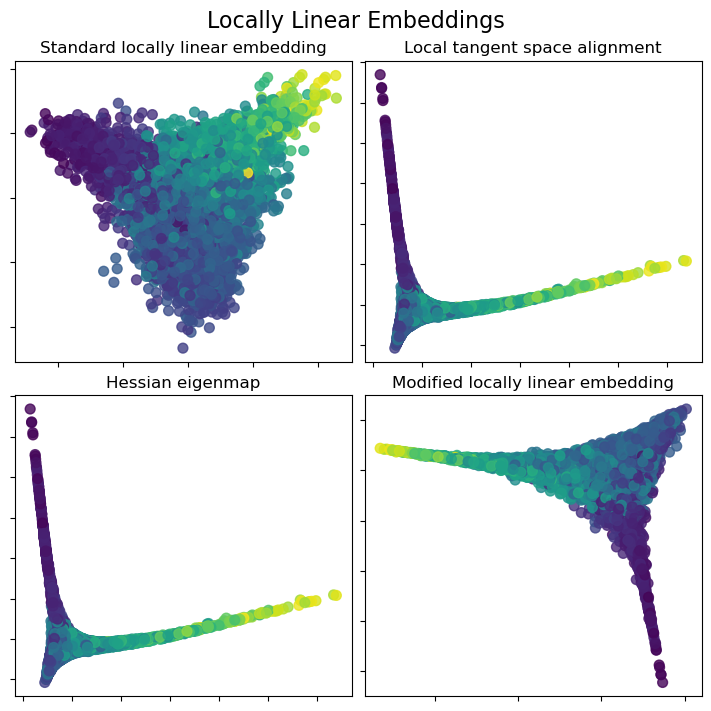

In [ ]:

fig, axs = plt.subplots(
    nrows=2, ncols=2, figsize=(7, 7), facecolor="white", constrained_layout=True
)
fig.suptitle("Locally Linear Embeddings", size=16)

lle_methods = [
    ("Standard locally linear embedding", S_standard),
    ("Local tangent space alignment", S_ltsa),
    ("Hessian eigenmap", S_hessian),
    ("Modified locally linear embedding", S_mod),
]
for ax, method in zip(axs.flat, lle_methods):
    name, points = method
    add_2d_scatter(ax, points, S_color, name)

plt.show()

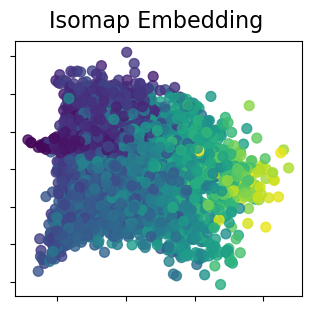

In [136]:
isomap = manifold.Isomap(n_neighbors=n_neighbors, n_components=n_components, p=1)
S_isomap = isomap.fit_transform(S_points)

plot_2d(S_isomap, S_color, "Isomap Embedding")

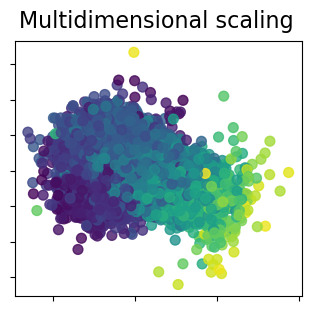

In [137]:
md_scaling = manifold.MDS(
    n_components=n_components,
    max_iter=50,
    n_init=4,
    random_state=0,
    normalized_stress=False,
)
S_scaling = md_scaling.fit_transform(S_points)

plot_2d(S_scaling, S_color, "Multidimensional scaling")

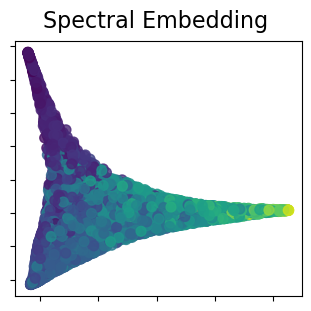

In [138]:
spectral = manifold.SpectralEmbedding(
    n_components=n_components, n_neighbors=n_neighbors, random_state=42
)
S_spectral = spectral.fit_transform(S_points)

plot_2d(S_spectral, S_color, "Spectral Embedding")

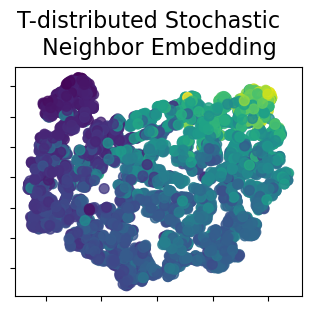

In [140]:
t_sne = manifold.TSNE(
    n_components=n_components,
    perplexity=30,
    init="random",
    random_state=0,
)
S_t_sne = t_sne.fit_transform(S_points)

plot_2d(S_t_sne, S_color, "T-distributed Stochastic  \n Neighbor Embedding")

In [236]:

from sklearn import manifold
from scipy.interpolate import CubicSpline

class LocalPrincipalCurve:
    def __init__(self, bandwidth=0.2, max_iter=100, tol=1e-4, angle_penalty_exp=2, h=None, 
                 use_local_embedding=False, n_neighbors=100, n_components=2):
        """
        Initialize the Local Principal Curve solver.

        Parameters:
        - bandwidth: The kernel bandwidth (h). If h is not provided, bandwidth is used as h.
        - max_iter: Maximum number of iterations for forward/backward runs.
        - tol: Tolerance for stopping criterion based on changes in µ_x.
        - angle_penalty_exp: Exponent k used in angle penalization: a_x(i) = |cos(alpha_x(i))|^k.
        - h: Step size t0. If None, set t0 = bandwidth.
        - use_local_embedding: If True, compute LTSA embedding and use it to define weights.
        - n_neighbors: Number of neighbors for LLE if use_local_embedding is True.
        - n_components: Dimensionality of the LTSA embedding.
        """

        self.bandwidth = bandwidth
        self.h = h if h is not None else self.bandwidth
        self.max_iter = max_iter
        self.tol = tol
        self.angle_penalty_exp = angle_penalty_exp
        self.use_local_embedding = use_local_embedding
        self.n_neighbors = n_neighbors
        self.n_components = n_components

        self.initializations = []
        self.paths = []
        self.cubic_splines_eq = []
        self.cubic_splines = []
        self.embedding = None  # Will store LTSA embedding if use_local_embedding is True.

    def _kernel_weights(self, dataset, x):
        """Compute Gaussian kernel weights w_i = K_h(X_i - x).
           If use_local_embedding is True, compute distances in LTSA-embedded space."""
        # Find the index of the point x in dataset space.
        # Because x may not be exactly in dataset, we find the closest point in the dataset to x.
        # For weighting, we need a consistent approach:
        # We'll use nearest embedding by searching the closest point in original space.
        # However, to simplify, we can just use x in dataset space and project to embedding space.
        
        # If using embedding:
        # 1. Find the closest point in dataset to x and use its index to get embedding coordinates.
        diffs = dataset - x
        dists_raw = np.linalg.norm(diffs, axis=1)
        min_idx = np.argmin(dists_raw)
        # The reference embedding point
        if self.use_local_embedding and self.embedding is not None:
            x_embed = self.embedding[min_idx]  # embedding coords of closest dataset point to x
            # Distances in embedding space
            dists = np.linalg.norm(self.embedding - x_embed, axis=1)
        else:
            # Distances in raw space
            dists = dists_raw

        weights = np.exp(- (dists**2) / (2 * self.bandwidth**2))
        w = weights / np.sum(weights)
        return w

    def _local_center_of_mass(self, dataset, x):
        """Compute µ_x, the local center of mass around x."""
        w = self._kernel_weights(dataset, x)
        mu = np.sum(dataset.T * w, axis=1)
        return mu

    def _local_covariance(self, dataset, x, mu):
        """Compute the local covariance matrix Σ_x."""
        w = self._kernel_weights(dataset, x)
        centered = dataset - mu
        cov = np.zeros((dataset.shape[1], dataset.shape[1]))
        for i in range(len(dataset)):
            cov += w[i] * np.outer(centered[i], centered[i])
        return cov

    def _principal_component(self, cov, prev_vec=None):
        """Compute the first local principal component γ_x, with angle penalization."""
        vals, vecs = np.linalg.eig(cov)
        idx = np.argsort(vals)[::-1]
        vals = vals[idx]
        vecs = vecs[:, idx]

        gamma = vecs[:, 0]  # first principal component

        # Sign flipping to maintain direction if prev_vec is given
        if prev_vec is not None and np.linalg.norm(prev_vec) != 0:
            cos_alpha = np.dot(gamma, prev_vec) / (np.linalg.norm(gamma)*np.linalg.norm(prev_vec))
            if cos_alpha < 0:
                gamma = -gamma

            # Angle penalization
            cos_alpha = np.dot(gamma, prev_vec) / (np.linalg.norm(gamma)*np.linalg.norm(prev_vec))
            a_x = (abs(cos_alpha))**self.angle_penalty_exp
            gamma = a_x * gamma + (1 - a_x) * prev_vec
            gamma /= np.linalg.norm(gamma)

        return gamma

    def _forward_run(self, dataset, x_start):
        """Run the algorithm forward from a starting point using the full dataset."""
        x = x_start
        path_x = [x]
        prev_gamma = None

        for _ in range(self.max_iter):
            mu = self._local_center_of_mass(dataset, x)
            cov = self._local_covariance(dataset, x, mu)
            gamma = self._principal_component(cov, prev_vec=prev_gamma)

            x_new = mu + self.h * gamma

            # Check convergence
            if np.linalg.norm(mu - x) < self.tol:
                path_x.append(x_new)
                break

            path_x.append(x_new)
            x = x_new
            prev_gamma = gamma

        return np.array(path_x)

    def _backward_run(self, dataset, x0, gamma0):
        """Run the algorithm backwards from x(0) along -γ_x(0)."""
        x = x0
        path_x = [x]
        prev_gamma = -gamma0

        for _ in range(self.max_iter):
            mu = self._local_center_of_mass(dataset, x)
            cov = self._local_covariance(dataset, x, mu)
            gamma = self._principal_component(cov, prev_vec=prev_gamma)

            x_new = mu + self.h * gamma

            if np.linalg.norm(mu - x) < self.tol:
                path_x.append(x_new)
                break

            path_x.append(x_new)
            x = x_new
            prev_gamma = gamma

        return np.array(path_x)

    def _find_starting_point(self, dataset, start_point):
        """Find a valid starting point in or close to the dataset."""
        if start_point is None:
            idx = np.random.choice(len(dataset))
            return dataset[idx], idx
        else:
            diffs = dataset - start_point
            dists = np.linalg.norm(diffs, axis=1)
            min_idx = np.argmin(dists)
            closest_pt = dataset[min_idx]
            if not np.allclose(closest_pt, start_point):
                print(f"Starting point not in dataset. Using closest point: {closest_pt}")
            return closest_pt, min_idx

    def fit(self, dataset, start_points=None):
        """
        Fit LPC on the dataset using possibly multiple starting points.

        If use_local_embedding is True, compute LTSA embedding first.

        Parameters:
        - dataset: n x p array
        - start_points: List of starting points or None.

        Returns:
        - self.paths: List of arrays, each array is a path from one initialization.
        """
        dataset = np.array(dataset)
        self.paths = []
        self.initializations = []

        # 1. If use_local_embedding, compute LTSA embedding for the dataset
        if self.use_local_embedding:
            params = {
                "n_neighbors": self.n_neighbors,
                "n_components": self.n_components,
                "eigen_solver": "auto",
                "random_state": 0,
                "method": "ltsa"
            }
            lle = manifold.LocallyLinearEmbedding(**params)
            self.embedding = lle.fit_transform(dataset)

            # Check for NaN values
            if np.isnan(self.embedding).any():
                print("Warning: The embedding contains NaN values.")
            else:
                print("Success: No NaN values found in the embedding.")

            # Check for Inf values
            if np.isinf(self.embedding).any():
                print("Warning: The embedding contains Inf values.")
            else:
                print("Success: No Inf values found in the embedding.")

            # Combined check
            if not np.isfinite(self.embedding).all():
                print("Error: The embedding contains NaN or Inf values.")
                # You can choose to handle this situation, for example:
                # - Remove or impute invalid values
                # - Re-run LLE with different parameters
                # - Investigate the input data for anomalies
            else:
                print("Success: The embedding has no NaN or Inf values.")

        else:
            self.embedding = None

        if start_points is None:
            start_points = [None]

        for sp in start_points:
            x0, _ = self._find_starting_point(dataset, sp)

            # 2. Forward run
            forward_path = self._forward_run(dataset, x0)
            if len(forward_path) > 1:
                initial_gamma_direction = (forward_path[1] - forward_path[0]) / self.h
            else:
                initial_gamma_direction = np.zeros(dataset.shape[1])

            # 3. Backward run (if initial gamma direction is not zero)
            if np.linalg.norm(initial_gamma_direction) > 0:
                backward_path = self._backward_run(dataset, x0, initial_gamma_direction)
                full_path = np.vstack([backward_path[::-1], forward_path[1:]])
            else:
                full_path = forward_path

            self.paths.append(full_path)
            self.initializations.append(x0)

        self._fit_cubic_splines_eq()
        self._compute_cubic_spline_points()
        return self.paths

    def _fit_cubic_splines_eq(self):
        """Fit cubic splines (equations) for all paths."""
        self.cubic_splines_eq = []
        for path in self.paths:
            if len(path) < 4:
                self.cubic_splines_eq.append(None)
                continue
            t = np.arange(len(path))
            splines_dict = {}
            for dim in range(path.shape[1]):
                splines_dict[dim] = CubicSpline(t, path[:, dim])
            self.cubic_splines_eq.append(splines_dict)

    def _compute_cubic_spline_points(self, num_points=500):
        """
        Compute parameterized points from each cubic spline equation.
        This fills self.cubic_splines with arrays of evaluated points.
        """
        self.cubic_splines = []
        for i, eq in enumerate(self.cubic_splines_eq):
            if eq is None:
                self.cubic_splines.append(None)
                continue
            path = self.paths[i]
            t_values = np.linspace(0, len(path) - 1, num_points)
            spline_points = self.evaluate_cubic_spline(i, t_values)
            self.cubic_splines.append(spline_points)

    def evaluate_cubic_spline(self, path_idx, t_values):
        """Evaluate the cubic spline equation for a specific path at given parameter values."""
        if path_idx >= len(self.cubic_splines_eq) or self.cubic_splines_eq[path_idx] is None:
            raise ValueError(f"No cubic spline found for path index {path_idx}.")
        spline = self.cubic_splines_eq[path_idx]
        points = np.array([spline[dim](t_values) for dim in range(len(spline))]).T
        return points

    def plot_path_3d(self, dataset, path_idx=0):
        """Plot dataset and one LPC path in 3D for visualization."""
        import matplotlib.pyplot as plt

        dataset = np.array(dataset)
        path = self.paths[path_idx]
        fig = plt.figure()
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(dataset[:,0], dataset[:,1], dataset[:,2], alpha=0.5, label='Data')
        ax.plot(path[:,0], path[:,1], path[:,2], 'r-', label='Local Principal Curve')
        ax.legend()
        plt.show()

    def plot_cubic_spline_3d(self, path_idx, t_values=None, show_path=True):
        """
        Plot the cubic spline for a specific path in 3D.

        Parameters:
        - path_idx: Index of the path to plot the spline for.
        - t_values: Optional parameter values to plot the spline at.
                    If None, t_values will be automatically generated.
        - show_path: Boolean flag to indicate whether to plot the LPC path points.
        """
        import matplotlib.pyplot as plt

        if path_idx >= len(self.paths):
            raise IndexError(f"Path index {path_idx} is out of range. Total paths: {len(self.paths)}.")

        path = self.paths[path_idx]
        if t_values is None:
            t_values = np.linspace(0, len(path) - 1, 500)

        spline_points = self.evaluate_cubic_spline(path_idx, t_values)

        fig = plt.figure()
        ax = fig.add_subplot(111, projection="3d")

        if show_path:
            ax.scatter(path[:, 0], path[:, 1], path[:, 2], label="LPC Path", alpha=0.5)

        ax.plot(spline_points[:, 0], spline_points[:, 1], spline_points[:, 2], color="red", label="Cubic Spline")
        ax.legend()
        plt.show()


In [267]:

import plotly.graph_objects as go
import os
import plotly.express as px

pert_comparisons = ["wnt-i", "wt"]


for model_index in [12]:
    print(model_index)
    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]

    print(merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0])

    score    = merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0]
    mweight  = merged_df_avg[merged_df_avg["model_index"]==model_index]["metric_weight"].iloc[0]
    timeonly = merged_df_avg[merged_df_avg["model_index"]==model_index]["time_only_flag"].iloc[0]
 
    df_all = pd.read_csv(path_all)

   
    df_hld = pd.read_csv(path_hld)

    title = f"PCA plot model_idx {model_index}: F1 score {score:.2f},mweight {mweight}, timeonly {timeonly}"
    # save_dir = f"/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis/plots/{title}".replace(" ", "_")
    # os.makedirs(save_dir, exist_ok=True)

    print(title)

    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    # pert_comparisons = ["wnt-i", "wt"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]


# Assuming df_all and df_hld are defined somewhere above.
# Run the code for df_all and df_hld separately

# Define perturbations and assign each a distinct color
# pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

# Dictionary to store spline points for each dataset and perturbation
# Key: (dataset_label, perturbation), Value: array of spline points shape (num_spline_points, 3)
splines_dict = {}

# Replace this with your actual class or method for fitting local principal curves

# Directory to save results
save_dir = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241210"
os.makedirs(save_dir, exist_ok=True)


for df_label, df in [("all", df_all)]:
    fig = go.Figure()
    
    # Filter the DataFrame for the given perturbation
    X = df[z_mu_biological_columns].values
    pca = PCA(n_components=3)
    pcs = pca.fit_transform(X)

    perturbations = pert_comparisons

    # Map perturbations to colors
    if perturbations is None:
        perturbations = df['phenotype'].unique()
    color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}


    # Prepare the color array
    df['color'] = df['phenotype'].map(color_discrete_map)


    df["PCA_1"] = pcs[:,0]
    df["PCA_2"] = pcs[:,1]
    df["PCA_3"] = pcs[:,2]

    for pert in pert_comparisons:
        print(f"Processing {pert} in {df_label} dataset...")


        pert_df = df[df["phenotype"] == pert].reset_index(drop=True)


        avg_early_timepoint = pert_df[
            (pert_df["predicted_stage_hpf"] >= pert_df["predicted_stage_hpf"].min()) &
            (pert_df["predicted_stage_hpf"] < pert_df["predicted_stage_hpf"].min() + 1)
        ][["PCA_1", "PCA_2", "PCA_3"]].mean().values

        # Downsampling logic
        if pert == "wt":
            pert_df_subset = pert_df.sample(frac=0.05, random_state=42)
        else:
            pert_df_subset = pert_df.sample(frac=.1, random_state=42)
        
        print(f"Subset size: {len(pert_df_subset)}")

        pert_3d_subset = pert_df_subset[["PCA_1", "PCA_2", "PCA_3"]].values


        # Fit the Local Principal Curve on the subset
        lpc = LocalPrincipalCurve(bandwidth=.5, max_iter=500, tol=1e-4, angle_penalty_exp=3, use_local_embedding=False)
        paths = lpc.fit(pert_3d_subset, start_points=[avg_early_timepoint])

        # Extract the first path (assuming one main path)
        spline_points = lpc.cubic_splines[0]  # shape: (num_points, 3)

        # Store the spline points in the dictionary
        splines_dict[(df_label, pert)] = spline_points

        # Add the original points of this perturbation to the figure
        fig.add_trace(
            go.Scatter3d(
                x=pert_3d_subset[:,0],
                y=pert_3d_subset[:,1],
                z=pert_3d_subset[:,2],
                mode='markers',
                marker=dict(
                    size=3,
                    color=pert_df_subset["predicted_stage_hpf"],     # Marker colors based on predicted_stage_hpf
                    colorscale='Viridis',          # Viridis colormap for numerical coloring
                    opacity=0.1  # slightly more visible than .01
                )
            )
        )

        # Add the cubic spline curve for this perturbation
        if spline_points is not None:
            fig.add_trace(
                go.Scatter3d(
                    x=spline_points[:,0],
                    y=spline_points[:,1],
                    z=spline_points[:,2],
                    mode='lines',
                    line=dict(width=8),
                    name=f"{pert} Cubic Spline ({df_label})",
                    showlegend=True,
                    line_color=color_map[pert]
                )
            )

    # Update layout for a clean look
    fig.update_layout(
        scene=dict(
            xaxis_title='PCA_1',
            yaxis_title='PCA_2',
            zaxis_title='PCA_3'
        ),
        title=f"Local Principal Curves for Multiple Perturbations ({df_label})"
    )

    # Save the figure for this dataset
    # fig.write_html(os.path.join(save_dir, f"{df_label}_splines_78.html"))

fig.show()


12
0.6195788537714659


/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/4196077429.py:21: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/4196077429.py:24: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



PCA plot model_idx 12: F1 score 0.62,mweight 25, timeonly 0
Processing wnt-i in all dataset...
Subset size: 187
Starting point not in dataset. Using closest point: [-1.09758623  4.22352464  0.37193074]
Processing wt in all dataset...
Subset size: 2437
Starting point not in dataset. Using closest point: [-2.27524191  3.07046071 -3.38398605]


In [ ]:
pert_df 

In [206]:
dataset

array([[ 0.96571221,  2.07394723, -1.57808752],
       [-7.54026156, -1.13781843,  3.0959517 ],
       [ 0.43019135,  1.99248292,  0.05004605],
       ...,
       [16.55631065, -3.98850823, -4.31326707],
       [-2.37908594,  5.14973745,  1.64407969],
       [-2.90995722, -0.75623443, -0.26827652]])

In [207]:
import numpy as np
import plotly.graph_objects as go
from matplotlib import pyplot as plt
import os
import plotly.express as px

pert_comparisons = ["wt"]


for model_index in [78]:
    print(model_index)
    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]

    print(merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0])

    score    = merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0]
    mweight  = merged_df_avg[merged_df_avg["model_index"]==model_index]["metric_weight"].iloc[0]
    timeonly = merged_df_avg[merged_df_avg["model_index"]==model_index]["time_only_flag"].iloc[0]
 
    df_all = pd.read_csv(path_all)

   
    df_hld = pd.read_csv(path_hld)

    title = f"PCA plot model_idx {model_index}: F1 score {score:.2f},mweight {mweight}, timeonly {timeonly}"
    # save_dir = f"/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis/plots/{title}".replace(" ", "_")
    # os.makedirs(save_dir, exist_ok=True)

    print(title)

    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    # pert_comparisons = ["wnt-i", "wt"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]


# Assuming df_all and df_hld are defined somewhere above.
# Run the code for df_all and df_hld separately

# Define perturbations and assign each a distinct color
# pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

# Dictionary to store spline points for each dataset and perturbation
# Key: (dataset_label, perturbation), Value: array of spline points shape (num_spline_points, 3)
splines_dict = {}

# Replace this with your actual class or method for fitting local principal curves

# Directory to save results
save_dir = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209"
os.makedirs(save_dir, exist_ok=True)

for df_label, df in [("all", df_all), ("hld", df_hld)]:
    fig = go.Figure()

    
    # Filter the DataFrame for the given perturbation
    X = df[z_mu_biological_columns].values
    pca = PCA(n_components=3)
    pcs = pca.fit_transform(X)

    perturbations = pert_comparisons

    # Map perturbations to colors
    if perturbations is None:
        perturbations = df['phenotype'].unique()
    color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}


    # Prepare the color array
    df['color'] = df['phenotype'].map(color_discrete_map)


    df["PCA_1"] = pcs[:,0]
    df["PCA_2"] = pcs[:,1]
    df["PCA_3"] = pcs[:,2]

    for pert in pert_comparisons:
        print(f"Processing {pert} in {df_label} dataset...")


        pert_df = df[df["phenotype"] == pert]


        avg_early_timepoint = pert_df[
            (pert_df["predicted_stage_hpf"] >= pert_df["predicted_stage_hpf"].min()) &
            (pert_df["predicted_stage_hpf"] < pert_df["predicted_stage_hpf"].min() + 1)
        ][["PCA_1", "PCA_2", "PCA_3"]].mean().values

        # Downsampling logic
        if pert == "wt":
            pert_df_subset = pert_df[np.random.RandomState(42).choice(len(pert_df), 
                                              size=int(0.2 * len(pert_df)), replace=False)]
        else:
            pert_df_subset = pert_df[np.random.RandomState(42).choice(len(pert_df), 
                                              size=int(1 * len(pert_df)), replace=False)]
        
        print(f"Subset size: {len(pert_df)}")

        pert_3d_subset = pert_df_subset[["PCA_1", "PCA_2", "PCA_3"]].values

        break


78
0.7591386184650808


/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/163255896.py:21: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/163255896.py:24: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



PCA plot model_idx 78: F1 score 0.76,mweight 50, timeonly 1
Processing wnt-i in all dataset...


KeyError: "None of [Index([1704, 1198, 1461,  275,  416, 1034,  247,  383,  322,  203,\n       ...\n        121, 1638, 1044, 1724, 1095, 1130, 1294,  860, 1459, 1126],\n      dtype='int64', length=1873)] are in the [columns]"

In [ ]:

params = {
    "n_neighbors": 100,
    "n_components": 3,
    "eigen_solver": "auto",
    "random_state": 0,
}

lle = manifold.LocallyLinearEmbedding(method="ltsa", **params)


embedding = lle.fit_transform(dataset)

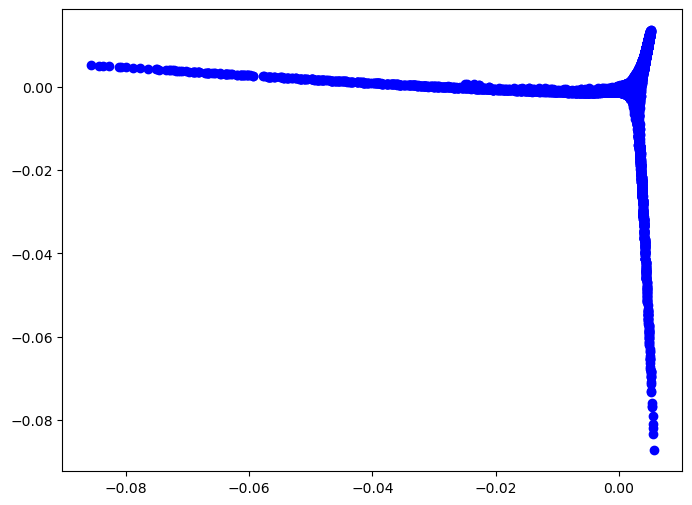

In [ ]:
# Create a plot
plt.figure(figsize=(8, 6))
plt.scatter(embedding[:,0], embedding[:,1], marker='o', linestyle='-', color='b', label='Data Line')  # Line plot
plt.show()

In [228]:

import plotly.graph_objects as go
import os
import plotly.express as px

pert_comparisons = ["wt","wnt-i"]


for model_index in [78]:
    print(model_index)
    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]

    print(merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0])

    score    = merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0]
    mweight  = merged_df_avg[merged_df_avg["model_index"]==model_index]["metric_weight"].iloc[0]
    timeonly = merged_df_avg[merged_df_avg["model_index"]==model_index]["time_only_flag"].iloc[0]
 
    df_all = pd.read_csv(path_all)

   
    df_hld = pd.read_csv(path_hld)

    title = f"PCA plot model_idx {model_index}: F1 score {score:.2f},mweight {mweight}, timeonly {timeonly}"
    # save_dir = f"/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis/plots/{title}".replace(" ", "_")
    # os.makedirs(save_dir, exist_ok=True)

    print(title)

    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    # pert_comparisons = ["wnt-i", "wt"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]


# Assuming df_all and df_hld are defined somewhere above.
# Run the code for df_all and df_hld separately

# Define perturbations and assign each a distinct color
# pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]

color_map = {
    "wnt-i": "red",
    "tgfb-i": "green",
    "wt": "blue",
    "lmx1b": "orange",
    "gdf3": "purple"
}

# Dictionary to store spline points for each dataset and perturbation
# Key: (dataset_label, perturbation), Value: array of spline points shape (num_spline_points, 3)
splines_dict = {}

# Replace this with your actual class or method for fitting local principal curves

# Directory to save results
save_dir = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241209"
os.makedirs(save_dir, exist_ok=True)

for df_label, df in [("all", df_all), ("hld", df_hld)]:
    fig = go.Figure()

    
    # Filter the DataFrame for the given perturbation
    X = df[z_mu_biological_columns].values
    pca = PCA(n_components=3)
    pcs = pca.fit_transform(X)

    perturbations = pert_comparisons

    # Map perturbations to colors
    if perturbations is None:
        perturbations = df['phenotype'].unique()
    color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}


    # Prepare the color array
    df['color'] = df['phenotype'].map(color_discrete_map)


    df["PCA_1"] = pcs[:,0]
    df["PCA_2"] = pcs[:,1]
    df["PCA_3"] = pcs[:,2]

    for pert in pert_comparisons:
        print(f"Processing {pert} in {df_label} dataset...")


        pert_df = df[df["phenotype"] == pert].reset_index(drop=True)


        avg_early_timepoint = pert_df[
            (pert_df["predicted_stage_hpf"] >= pert_df["predicted_stage_hpf"].min()) &
            (pert_df["predicted_stage_hpf"] < pert_df["predicted_stage_hpf"].min() + 1)
        ][["PCA_1", "PCA_2", "PCA_3"]].mean().values

        # Downsampling logic
        if pert == "wt":
            pert_df_subset = pert_df.sample(frac=0.2, random_state=42)
        else:
            pert_df_subset = pert_df.sample(frac=1, random_state=42)
        
        print(f"Subset size: {len(pert_df)}")

        pert_3d_subset = pert_df_subset[["PCA_1", "PCA_2", "PCA_3"]].values

        break


78
0.7591386184650808


/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/2687741729.py:21: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/7033275.1.trapnell-login.q/ipykernel_2543652/2687741729.py:24: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.



PCA plot model_idx 78: F1 score 0.76,mweight 50, timeonly 1
Processing wt in all dataset...
Subset size: 48747
Processing wt in hld dataset...
Subset size: 48747


In [233]:
pert_df_subset

,Unnamed: 0,snip_id,experiment_date,medium,short_pert_name,control_flag,phenotype,predicted_stage_hpf,surface_area_um,length_um,...,UMAP_01_bio_3,UMAP_02_bio_3,UMAP_00_n_3,UMAP_01_n_3,UMAP_02_n_3,embryo_id,color,PCA_1,PCA_2,PCA_3
14829,17355,20230615_C12_e00_t0044,20230615,EM,wt_wik,0,wt,30.225125,9.489789e+05,2734.523642,...,5.663045,4.118945,8.351395,4.583152,-2.729602,20230615_C12_e00,#636EFA,1.573319,0.819333,-4.146263
10115,10115,20230602_H04_e00_t0024,20230602,EM,wt_wik,0,wt,26.292118,8.918156e+05,2518.870363,...,6.546882,4.195409,8.537903,5.344366,-2.595654,20230602_H04_e00,#636EFA,-5.766167,-1.468054,-3.621918
36315,74142,20240626_G04_e00_t0028,20240626,EM,wt_ab,0,wt,35.406228,1.073523e+06,2899.756753,...,7.027577,0.789388,11.024534,2.764407,5.478731,20240626_G04_e00,#636EFA,2.823731,1.522862,-3.387421
25736,55348,20240509_H10_e00_t0031,20240509,EM,wt_tbxta,0,wt,41.641635,7.668423e+05,2228.598100,...,5.878856,6.926259,6.675106,6.055472,0.515779,20240509_H10_e00,#636EFA,0.575125,-2.603101,-3.672826
6211,6211,20230531_G10_e00_t0057,20230531,EM,wt_wik,0,wt,41.592022,1.064347e+06,2591.744753,...,5.499188,6.353648,9.080036,6.053906,-3.903636,20230531_G10_e00,#636EFA,7.550733,-1.593039,1.599430
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10210,10210,20230602_H07_e00_t0032,20230602,EM,wt_wik,0,wt,30.109013,8.851042e+05,2224.014223,...,6.240074,5.338983,11.660641,1.161928,9.357574,20230602_H07_e00,#636EFA,0.264362,-0.899593,-2.511695
42406,80527,20240812_E11_e00_t0065,20240812,EM,wt_ab,0,wt,42.254747,7.623251e+05,2606.646568,...,3.552306,3.571140,13.284003,0.710417,6.882061,20240812_E11_e00,#636EFA,3.667461,-0.774958,-2.520921
34107,71934,20240626_E02_e00_t0104,20240626,EM,wt_ab,0,wt,65.953976,1.296083e+06,3539.977279,...,5.216756,-2.368272,11.790246,7.571184,-1.946543,20240626_E02_e00,#636EFA,16.636293,-3.291169,5.430510
27736,59300,20240522_F04_e00_t0013,20240522,EM,wt_tbx16,0,wt,16.298793,4.792416e+05,847.869201,...,-0.306843,4.570786,4.553338,6.663757,9.848790,20240522_F04_e00,#636EFA,-3.383028,6.337719,0.587584


In [229]:

params = {
    "n_neighbors": 100,
    "n_components": 3,
    "eigen_solver": "auto",
    "random_state": 0,
}

lle = manifold.LocallyLinearEmbedding(method="ltsa", **params)


embedding = lle.fit_transform(pert_3d_subset)

In [235]:
import plotly.graph_objects as go

# Create the 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=embedding[:, 0],                # X-axis coordinates
    y=embedding[:, 1],                # Y-axis coordinates
    z=embedding[:, 2],                # Z-axis coordinates
    mode='markers',
    marker=dict(
        size=5,                        # Marker size
        color=pert_df_subset["predicted_stage_hpf"],     # Marker colors based on predicted_stage_hpf
        colorscale='Viridis',          # Viridis colormap for numerical coloring
        opacity=0.8,                   # Marker transparency
        colorbar=dict(
            title='Predicted Stage HPF'  # Title for the colorbar
        ),
        # line=dict(width=0.5, color='DarkSlateGrey')  # Marker edge properties
    ),
    # text=predicted_stage_hpf.astype(str),  # Text to display on hover (convert integers to strings)
    # hoverinfo='text'                        # Show only the text on hover
)])

# Update layout with axis labels and title
fig.update_layout(
    title='3D Scatter Plot of Embedding Data Colored by Predicted Stage HPF',
    scene=dict(
        xaxis_title='X Axis Label',
        yaxis_title='Y Axis Label',
        zaxis_title='Z Axis Label'
    )
)

# Show the plot
fig.show()

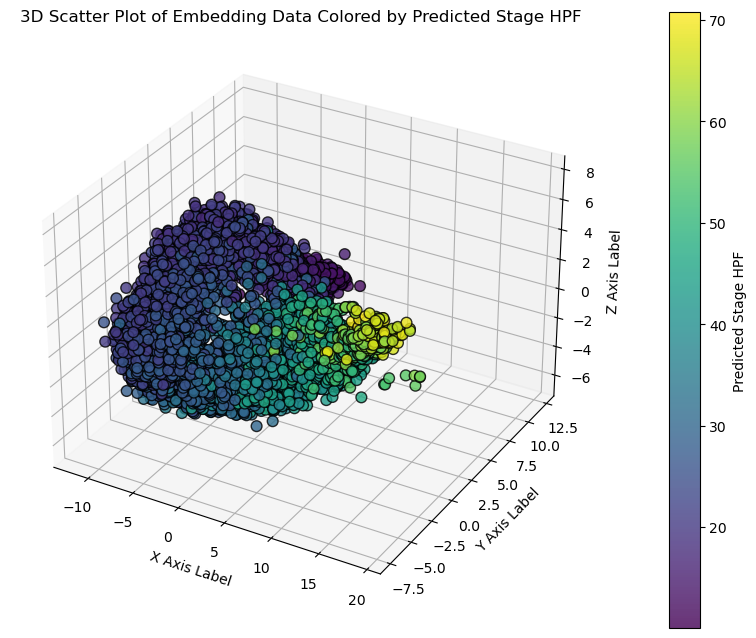

In [231]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Assuming 'embedding' is your NumPy array with shape (n_samples, 3)
# and 'pert_df' is your pandas DataFrame with 'predicted_stage_hpf' column

# Example setup (Replace this with your actual data)
# -----------------------------------------------------------------
# Uncomment and replace the following lines with your actual data
# embedding = your_embedding_array  # Shape: (n_samples, 3)
# pert_df = your_dataframe          # Must contain 'predicted_stage_hpf' column
# -----------------------------------------------------------------




# Create a new figure for the 3D plot
fig = plt.figure(figsize=(10, 8))
ax = fig.add_subplot(111, projection='3d')  # Create a 3D subplot

# Create a 3D scatter plot colored by 'predicted_stage_hpf'
scatter = ax.scatter(
    pert_3d_subset[:, 0],          # X-axis data
    pert_3d_subset[:, 1],          # Y-axis data
    pert_3d_subset[:, 2],          # Z-axis data
    c=pert_df_subset["predicted_stage_hpf"],   # Color based on 'predicted_stage_hpf'
    cmap="viridis",           # Colormap
    marker='o',               # Marker style
    edgecolor='k',            # Edge color for better visibility
    s=60,                     # Marker size
    alpha=0.8                 # Transparency
)

# Add a colorbar to the plot
cbar = plt.colorbar(scatter, ax=ax, pad=0.1)
cbar.set_label(color_label)

# Set labels for each axis
ax.set_xlabel('X Axis Label')
ax.set_ylabel('Y Axis Label')
ax.set_zlabel('Z Axis Label')

# Set a title for the plot
ax.set_title('3D Scatter Plot of Embedding Data Colored by Predicted Stage HPF')

# Show the plot
plt.show()

In [204]:
len(embedding)

9749